# 1. **Environment & Imports**

## LISS-3 Data: Loading, Preprocessing, Index Calculation & Metadata Integration

**Key Steps**:
1. **Unzip** L1T data for each swath (which contains the 4 separate TIF bands, plus a metadata `.txt`).
2. **Load** those 4 bands (b2=Green, b3=Red, b4=NIR, b5=SWIR).
3. **Preprocess** each band (outlier removal, optional FFT destriping, median filtering, contrast stretching, etc.).
4. **Compute** spectral indices (NDVI, NDWI, SAVI, EVI, GNDVI, BSI, MNDWI, RVI, MSAVI, NBR, IPVI, UI, BULI, SBI).
5. **Optionally** read a shape or KMZ file, interpolate/rasterize an attribute to each pixel to form a "metadata band."
6. **Georeference** the output using L1T metadata or external shapefile.
7. **Save** final multi-band TIF (4 processed bands + optional metadata band).
8. **(Placeholder)**: SIFT/ORB + RANSAC for mosaic creation if needed.
9. **(Placeholder)**: Additional visualization routines.

We structure the code so each step can be **rerun** or **skipped** if the user has already created an intermediate result.

## 1.1 Requirements Handling

In [ ]:
!conda activate myenv

with open("L3rq.txt","w") as rqfl:
    rqfl.write("""
requests
numpy
rasterio
geopandas
scipy
shapely
matplotlib
scikit-learn
opencv-python
shapely
xgboost
pyproj
pathlib
scikit-image
ipywidgets
cython
hdbscan
torch
torchvision
git+https://github.com/openai/CLIP.git
Pillow
segment-anything
""")

!uv pip install --upgrade -r L3rq.txt
!wget https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth

## 1.2 Imports

In [1]:
#############################################
# Imports & Environment Setup
#############################################

# Standard Libraries
import os
import gc
import re
import math
import shutil
import psutil
import warnings
import requests
from pathlib import Path
from zipfile import ZipFile

# Numerical & Scientific Computing
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import mode
from scipy import ndimage, stats
from scipy.signal import medfilt2d

# Geospatial & Raster Processing
import rasterio
from rasterio.io import MemoryFile
from rasterio.transform import Affine
from rasterio.warp import calculate_default_transform, reproject, Resampling
from rasterio.features import rasterize
from rasterio import mask
from rasterio.plot import show

from pyproj import CRS
import geopandas as gpd
from shapely.geometry import box

# Machine Learning
import xgboost as xgb  # (if needed for baseline; primary model is deep learning-based)
import joblib
from joblib import Parallel, delayed
from sklearn.neighbors import NearestNeighbors
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans, DBSCAN, MiniBatchKMeans
from sklearn.preprocessing import StandardScaler, LabelEncoder

# Computer Vision
import cv2

# Deep Learning & Related Libraries
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms

# Image Processing & Experiment Tracking
from PIL import Image
import wandb

# CLIP Model for Preprocessing and Fallback
import clip

# Segment Anything Model (SAM) - Optional for Advanced Segmentation
try:
    from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
    USE_SAM = True
    print("SAM found – using Segment Anything Model for segmentation.")
except ImportError:
    USE_SAM = False
    print("SAM not found – falling back to CLIP visual encoder.")

# Device Setup: Use GPU if available, otherwise use CPU
device = "cuda" if torch.cuda.is_available() else "cpu"

# Load CLIP Model (ViT-B/32) along with its preprocessing pipeline
clip_model, clip_preprocess = clip.load("ViT-B/32", device=device)

# Suppress Warnings for Cleaner Output
warnings.filterwarnings('ignore')
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", category=rasterio.errors.NotGeoreferencedWarning)

print("Environment set up successfully with CLIP and SAM (if available)!")

SAM found – using Segment Anything Model for segmentation.
Environment set up successfully with CLIP and SAM (if available)!


# 2. **Common (Helper) Functions**

This block gathers **generic** functionality we’ll use later (unzip, parse L1T meta, etc.). You can skip re-running it if you already have them in memory.

In [2]:
def unzip_swath(zip_path: str, output_folder: str) -> None:
    """
    Unzip a single L1T zip file (containing *_b2_l1t.tif, etc.) to output_folder.
    If output_folder doesn't exist, create it.
    """
    if not os.path.exists(output_folder):
        os.makedirs(output_folder, exist_ok=True)
    print(f"[Unzip] Extracting {os.path.basename(zip_path)} -> {output_folder}")
    with ZipFile(zip_path, 'r') as zf:
        zf.extractall(output_folder)

def unzip_shapefile(zip_path: str, output_folder: str) -> str:
    """
    Unzip a shapefile zip and return the path to the .shp file
    """
    if not os.path.exists(output_folder):
        os.makedirs(output_folder, exist_ok=True)
        
    try:
        with ZipFile(zip_path, 'r') as zf:
            # Check for .shp file before extracting
            shp_files = [f for f in zf.namelist() if f.endswith('.shp')]
            if not shp_files:
                return None
                
            zf.extractall(output_folder)
            
            # Return path to first .shp file found
            for shp_file in shp_files:
                full_path = os.path.join(output_folder, shp_file)
                if os.path.exists(full_path):
                    return full_path
    except Exception as e:
        print(f"Error extracting shapefile: {str(e)}")
        return None
    
    return None

def parse_l1t_metadata(meta_txt_path: str) -> dict:
    """
    Reads a *_meta_l1t.txt file and returns a dictionary of key/value pairs.
    Adapt the parsing logic as per the actual format of your metadata.
    """
    meta_dict = {}
    if not os.path.exists(meta_txt_path):
        return meta_dict

    with open(meta_txt_path, 'r') as f:
        for line in f:
            line = line.strip()
            if '=' in line:
                key, val = line.split('=', 1)
                key = key.strip()
                val = val.strip()
                # Attempt to convert numeric
                if re.match(r'^-?\d+(\.\d+)?$', val):
                    val = float(val)
                meta_dict[key] = val
    return meta_dict


def create_transform_from_meta(meta_dict: dict, rows: int, cols: int) -> Affine:
    """
    Creates a rasterio Affine transform using L1T metadata. 
    The logic depends on how your metadata is stored.
    Example usage:
      if meta_dict has 'PRODUCT_UL_EASTING', 'PRODUCT_UL_NORTHING',
      and 'COLUMN_RESOLUTION', 'LINE_RESOLUTION'.
    Usually, y resolution is negative if top-left is the origin.
    Returns None if incomplete.
    """
    # Example fields: 
    # PRODUCT_UL_EASTING, PRODUCT_UL_NORTHING, COLUMN_RESOLUTION, LINE_RESOLUTION
    ulx = meta_dict.get('PRODUCT_UL_EASTING', None)
    uly = meta_dict.get('PRODUCT_UL_NORTHING', None)
    xres = meta_dict.get('COLUMN_RESOLUTION', None)
    yres = meta_dict.get('LINE_RESOLUTION', None)
    
    if (ulx is None) or (uly is None) or (xres is None) or (yres is None):
        return None
    
    # Typically, if UL is top-left, the transform is:
    #   [ xres,  0,     ulx
    #     0,    -yres, uly
    #     0,     0,     1 ]
    # Some LISS metadata might store positive LINE_RESOLUTION. We'll assume we must flip sign.
    return Affine(
        xres, 0.0, ulx,
        0.0, -abs(yres), uly
    )


def get_crs_from_meta(meta_dict: dict) -> CRS:
    """
    Attempt to build a Rasterio CRS from the textual metadata. 
    For example, if it says PROJECTION=UTM, DATUM=WGS84, ZONE=43 => EPSG:32643
    Adapt as needed for your actual data.
    Returns None if can't parse a known CRS.
    """
    projection = meta_dict.get('PROJECTION', None)
    datum = meta_dict.get('DATUM', None)
    zone = meta_dict.get('ZONE', None)

    if (projection == 'UTM') and (datum == 'WGS84') and (zone is not None):
        # Hard-coded example for northern hemisphere
        # For southern hemisphere, you might do "327<zone>"
        epsg_code = f"326{int(zone)}"
        try:
            return CRS.from_epsg(int(epsg_code))
        except:
            pass
    return None


def rasterize_gdf_to_array(gdf: gpd.GeoDataFrame, 
                           reference_profile: dict,
                           attribute: str = None,
                           fill_value: float = 0.0):
    """
    Rasterize a GeoDataFrame (e.g., from shapefile or KMZ) to match 
    the reference raster profile's shape, transform, and crs.
    If 'attribute' is provided, that field's value is burned into the raster.
    If not, 1 is used for polygons.
    """    
    if not gdf.crs:
        # We assume it is in the same CRS as the reference
        gdf = gdf.set_crs(reference_profile['crs'])
    elif gdf.crs != reference_profile['crs']:
        # reproject gdf to match reference
        gdf = gdf.to_crs(reference_profile['crs'])

    shapes = []
    if attribute is None:
        # burn 1
        for geom in gdf.geometry:
            shapes.append((geom, 1))
    else:
        for _, row in gdf.iterrows():
            val = row[attribute] if attribute in row else 1
            shapes.append((row.geometry, val))

    out_arr = rasterize(
        shapes=shapes,
        out_shape=(reference_profile['height'], reference_profile['width']),
        transform=reference_profile['transform'],
        fill=fill_value,
        dtype='float32'
    )
    return out_arr

print("Helper functions ready.")

Helper functions ready.


# 3. **Loader Class** (Unzipping + Reading 4 Bands)

In [3]:
class LISS3SwathLoader:
    """
    Combines:
    1) Unzip a single L1T .zip into a subfolder
    2) Identify b2/b3/b4/b5 TIF
    3) Read them in memory.
    4) Parse the meta_l1t.txt if present, to store georeferencing info
    """

    def __init__(self, zip_path_or_folder: str):
        """
        zip_path_or_folder: Either the path to e.g. R2LS3***_L1T.zip
                            or an already-unzipped folder containing 
                            b2, b3, b4, b5 TIFs + meta_l1t.txt.
        """
        self.base_path = zip_path_or_folder
        self.unzipped_folder = None
        self.bands_data = {}
        self.meta_dict = {}
        self.profile = {}
        # Decide if we need to unzip
        self._prepare_data()

    def _prepare_data(self):
        # if it's a .zip, unzip
        if os.path.isfile(self.base_path) and self.base_path.endswith(".zip"):
            out_folder = self.base_path.replace(".zip", "")
            if not os.path.exists(out_folder):
                unzip_swath(self.base_path, out_folder)
            self.unzipped_folder = out_folder
        else:
            # maybe it's already an unzipped folder
            self.unzipped_folder = self.base_path

        # Now parse the meta_l1t.txt if it exists
        meta_txt = None
        for f in os.listdir(self.unzipped_folder):
            if f.endswith("_meta_l1t.txt"):
                meta_txt = os.path.join(self.unzipped_folder, f)
                break
        if meta_txt:
            self.meta_dict = parse_l1t_metadata(meta_txt)

        # Identify the 4 TIF bands
        band_keys = {'b2': None, 'b3': None, 'b4': None, 'b5': None}
        for f in os.listdir(self.unzipped_folder):
            if f.endswith(".tif") and "_b" in f:
                # e.g. R2LS3****_b2_l1t.tif -> b2
                b_part = f.split("_")[-2]  # 'b2'
                if b_part in band_keys:
                    band_keys[b_part] = os.path.join(self.unzipped_folder, f)

        # read each band
        for bk, p in band_keys.items():
            if p is None:
                continue
            with rasterio.open(p) as src:
                data = src.read(1)
                prof = src.profile.copy()
            self.bands_data[bk] = data
            self.profile = prof  # store last read's profile (they should be identical in shape)

        # Attempt to incorporate the meta transform + crs
        rows, cols = next(iter(self.bands_data.values())).shape  # pick one band
        transform = create_transform_from_meta(self.meta_dict, rows, cols)
        crs = get_crs_from_meta(self.meta_dict)

        if transform:
            self.profile['transform'] = transform
        if crs:
            self.profile['crs'] = crs

        # Ensure consistent shape metadata
        self.profile['height'], self.profile['width'] = rows, cols

    def get_band(self, band_key: str) -> np.ndarray:
        if band_key not in self.bands_data:
            raise ValueError(f"Band {band_key} not available.")
        return self.bands_data[band_key]

    def list_bands(self):
        return list(self.bands_data.keys())

    def close(self):
        self.bands_data.clear()
        gc.collect()

    def __del__(self):
        self.close()

print("LISS3SwathLoader class ready.")

LISS3SwathLoader class ready.


# 4. **Processing Class** (Preprocessing, Indices, etc.)

In [4]:
class LISS3Preprocessor:
    """
    Provides functions for:
     - Outlier removal (z-score)
     - Median filtering
     - Optional FFT destriping
     - Contrast stretching + CLAHE
     - Index computations
    """
    def __init__(self, fft_destripe: bool = False):
        """
        Initialize preprocessor
        Args:
            fft_destripe: Whether to apply FFT destriping to bands
        """
        self.fft_destripe = fft_destripe
    
    def remove_outliers(self, band: np.ndarray, z_threshold=3.0) -> np.ndarray:
            """
            Remove outliers using z-score method with safe type casting
            
            Args:
                band: Input array
                z_threshold: Number of standard deviations for outlier detection
                
            Returns:
                Array of same type as input with outliers replaced
            """
            # Get valid value range for the data type
            dtype_info = np.iinfo(band.dtype) if band.dtype.kind in 'ui' else np.finfo(band.dtype)
            dtype_min, dtype_max = dtype_info.min, dtype_info.max
            
            # Convert to float32 for calculations
            arr_f = band.astype(np.float32)
            
            # Calculate robust statistics to avoid influence of outliers
            valid_data = arr_f[~np.isnan(arr_f)]
            if len(valid_data) == 0:
                return band  # Return original if all values are NaN
                
            mean = np.nanmean(arr_f)
            std = np.nanstd(arr_f)
            if std == 0:
                return band  # Return original if no variation
                
            # Calculate z-scores
            zscores = np.abs((arr_f - mean) / (std + 1e-10))
            
            # Create outlier mask
            mask = zscores > z_threshold
            
            # Replace outliers with local median
            if np.any(mask):
                arr_f[mask] = np.nan
                median_filtered = ndimage.median_filter(arr_f, size=3)
                arr_f[mask] = median_filtered[mask]
            
            # Ensure all NaN values are replaced
            if np.any(np.isnan(arr_f)):
                nan_mask = np.isnan(arr_f)
                arr_f[nan_mask] = mean
            
            # Clip to valid range for the data type before casting
            arr_clipped = np.clip(arr_f, dtype_min, dtype_max)
            
            # Handle specific data types
            if band.dtype == np.uint8:
                return np.clip(arr_clipped, 0, 255).astype(np.uint8)
            elif band.dtype == np.uint16:
                return np.clip(arr_clipped, 0, 65535).astype(np.uint16)
            else:
                return arr_clipped.astype(band.dtype)

    def median_filter(self, band: np.ndarray, ksize=3) -> np.ndarray:
        """Apply median filter to remove noise"""
        return medfilt2d(band, kernel_size=ksize)

    def fft_destripe_func(self, band: np.ndarray) -> np.ndarray:
        """Apply FFT-based destriping if enabled"""
        if not self.fft_destripe:
            return band
            
        fft_data = np.fft.fft2(band)
        fft_shift = np.fft.fftshift(fft_data)
        rows, cols = band.shape
        crow, ccol = rows // 2, cols // 2
        mask = np.ones((rows, cols), dtype=np.float32)
        # Zero out center row(s)
        mask[crow-1:crow+2, :] = 0
        fft_shift *= mask
        inv = np.fft.ifftshift(fft_shift)
        out = np.real(np.fft.ifft2(inv))
        return out

    def linear_stretch_8bit(self, band: np.ndarray, lower=2, upper=98) -> np.ndarray:
        """Apply linear contrast stretch to convert to 8-bit"""
        p_low, p_high = np.percentile(band, (lower, upper))
        band_clip = np.clip(band, p_low, p_high)
        norm = (band_clip - band_clip.min()) / (band_clip.max() - band_clip.min() + 1e-9)
        return (norm * 255.0).astype(np.uint8)

    def apply_clahe(self, band_8u: np.ndarray, clip_limit=2.0, tile_grid_size=(8,8)) -> np.ndarray:
        """Apply CLAHE for local contrast enhancement"""
        clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)
        return clahe.apply(band_8u)

    def preprocess_band(self, band: np.ndarray) -> np.ndarray:
        """Full preprocessing chain on one band"""
        clean = self.remove_outliers(band)
        clean = self.median_filter(clean)
        if self.fft_destripe:
            clean = self.fft_destripe_func(clean)
        band_8u = self.linear_stretch_8bit(clean)
        final_8u = self.apply_clahe(band_8u)
        return final_8u

    def compute_indices(self, green, red, nir, swir, eps=1e-10) -> dict:
        """
        Compute multiple spectral indices with safe floating-point operations
        """
        # Convert all inputs to float32 for calculations
        g = green.astype(np.float32)
        r = red.astype(np.float32)
        n = nir.astype(np.float32)
        s = swir.astype(np.float32)
        
        # Add small epsilon to denominators to avoid division by zero
        def safe_div(a, b):
            return np.divide(a, b + eps, out=np.zeros_like(a), where=b != 0)
        
        # Calculate indices with safe division
        ndvi = safe_div(n - r, n + r)
        ndwi = safe_div(g - n, g + n)
        L = 0.5
        savi = safe_div(n - r, n + r + L) * (1 + L)
        evi = 2.5 * safe_div(n - r, n + 6*r - 7.5*g + 1)
        gndvi = safe_div(n - g, n + g)
        bsi = safe_div((s + r) - (n + g), (s + r) + (n + g))
        mndwi = safe_div(g - s, g + s)
        ndbi = safe_div(s - n, s + n)
        ndmi = safe_div(n - s, n + s)
        rvi = safe_div(n, r)
        
        # MSAVI calculation with safe operations
        msavi_part = (2.0*n + 1.0)**2 - 8.0*(n - r)
        msavi_part = np.maximum(msavi_part, 0)  # Ensure non-negative under sqrt
        msavi = (2.0*n + 1.0 - np.sqrt(msavi_part)) / 2.0
        
        nbr = safe_div(n - s, n + s)
        ipvi = safe_div(n, n + r)
        ui = safe_div(r, n)
        buli = safe_div(s - n, s + n)
        sbi = np.sqrt(g*g + r*r + n*n + s*s + eps)
        
        # Clip indices to valid ranges
        indices = {
            'ndvi': np.clip(ndvi, -1, 1),
            'ndwi': np.clip(ndwi, -1, 1),
            'savi': np.clip(savi, -1, 1),
            'evi': np.clip(evi, -1, 1),
            'gndvi': np.clip(gndvi, -1, 1),
            'bsi': np.clip(bsi, -1, 1),
            'mndwi': np.clip(mndwi, -1, 1),
            'ndbi': np.clip(ndbi, -1, 1),
            'ndmi': np.clip(ndmi, -1, 1),
            'rvi': rvi,  # RVI can be > 1
            'msavi': np.clip(msavi, -1, 1),
            'nbr': np.clip(nbr, -1, 1),
            'ipvi': np.clip(ipvi, 0, 1),  # IPVI is [0,1]
            'ui': ui,  # UI can be > 1
            'buli': np.clip(buli, -1, 1),
            'sbi': sbi  # SBI is non-negative
        }
        
        return indices

    def compute_single_index(self, green, red, nir, swir, index_name, eps=1e-10):
        """Compute a single spectral index"""
        # Convert inputs to float32
        g = green.astype(np.float32)
        r = red.astype(np.float32)
        n = nir.astype(np.float32)
        s = swir.astype(np.float32)
        
        def safe_div(a, b):
            return np.divide(a, b + eps, out=np.zeros_like(a), where=b != 0)
        
        if index_name == 'ndvi':
            return safe_div(n - r, n + r)
        elif index_name == 'ndwi':
            return safe_div(g - n, g + n)
        elif index_name == 'savi':
            L = 0.5
            return safe_div(n - r, n + r + L) * (1 + L)
        elif index_name == 'evi':
            return 2.5 * safe_div(n - r, n + 6*r - 7.5*g + 1)
        elif index_name == 'gndvi':
            return safe_div(n - g, n + g)
        elif index_name == 'bsi':
            return safe_div((s + r) - (n + g), (s + r) + (n + g))
        elif index_name == 'mndwi':
            return safe_div(g - s, g + s)
        elif index_name == 'ndbi':
            return safe_div(s - n, s + n)
        elif index_name == 'ndmi':
            return safe_div(n - s, n + s)
        elif index_name == 'rvi':
            return safe_div(n, r)
        elif index_name == 'msavi':
            msavi_part = (2.0*n + 1.0)**2 - 8.0*(n - r)
            msavi_part = np.maximum(msavi_part, 0)
            return (2.0*n + 1.0 - np.sqrt(msavi_part)) / 2.0
        elif index_name == 'nbr':
            return safe_div(n - s, n + s)
        elif index_name == 'ipvi':
            return safe_div(n, n + r)
        elif index_name == 'ui':
            return safe_div(r, n)
        elif index_name == 'buli':
            return safe_div(s - n, s + n)
        elif index_name == 'sbi':
            return np.sqrt(g*g + r*r + n*n + s*s + eps)
        else:
            raise ValueError(f"Unknown index: {index_name}")

# 5. **Mosaic Creation** (SIFT/ORB + RANSAC)

In [5]:
def mosaic_images_sift(img1: np.ndarray, img2: np.ndarray):
    """
    Placeholder function:
    Use SIFT to find keypoints & descriptors, match them, compute homography.
    Return warped mosaic. Minimal example that might need adaptation for large images.
    """
    sift = cv2.SIFT_create()
    kp1, des1 = sift.detectAndCompute(img1, None)
    kp2, des2 = sift.detectAndCompute(img2, None)

    # FLANN
    index_params = dict(algorithm=1, trees=5) # FLANN_INDEX_KDTREE=1
    search_params = dict(checks=50)
    flann = cv2.FlannBasedMatcher(index_params, search_params)
    matches = flann.knnMatch(des1, des2, k=2)

    good = []
    for m,n in matches:
        if m.distance < 0.75*n.distance:
            good.append(m)
    if len(good) < 4:
        print("Not enough matches to mosaic.")
        return None

    src_pts = np.float32([kp1[m.queryIdx].pt for m in good]).reshape(-1,1,2)
    dst_pts = np.float32([kp2[m.trainIdx].pt for m in good]).reshape(-1,1,2)

    H, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    # Warp
    h2, w2 = img2.shape
    warped = cv2.warpPerspective(img1, H, (w2, h2))
    # Simple overlay
    mosaic = warped
    mask = (warped == 0)
    mosaic[mask] = img2[mask]
    return mosaic

print("SIFT-based mosaic function ready.")

SIFT-based mosaic function ready.


# 6. **Integrate Shapefile / KMZ as a Metadata Band**

In [6]:
def create_metadata_band_from_shapefile(shp_path: str,
                                        reference_profile: dict,
                                        attribute: str = None,
                                        fill_value: float = 0.0):
    """
    Rasterize the shapefile polygons to match the reference_profile
    and produce an array that can be appended as a 'metadata' band.
    If 'attribute' is None, we burn '1'. Otherwise, we burn the attribute values.
    """
    gdf = gpd.read_file(shp_path)
    # Rasterize
    meta_arr = rasterize_gdf_to_array(
        gdf, 
        reference_profile, 
        attribute=attribute,
        fill_value=fill_value
    )
    return meta_arr

# 7. **Main Driver: Load → Preprocess → Indices → Metadata → Save**
Below is the **primary** block that demonstrates how to:
1. **Scan** a base directory (like `./LISS3/`) to find subfolders or `_L1T.zip` files.  
2. **Use** `LISS3SwathLoader` to read the 4 bands.  
3. **Preprocess** each band into 8-bit.  
4. **Compute** spectral indices from the float data.  
5. **(Optionally)** incorporate shapefile-based metadata (rasterize) and add as a new band.  
6. **Save** everything as a single multi-band TIF or multiple TIFs.  
This also includes **georeferencing** if the `_meta_l1t.txt` was parsed successfully.

## 7.1 Defining methods

In [7]:
def find_files_by_pattern(base_dir: str, pattern: str) -> list:
    """
    Recursively find files matching pattern in base_dir and subdirectories
    Args:
        base_dir: Root directory to start search
        pattern: File pattern to match (e.g., '*_L1T.zip')
    Returns:
        List of full paths to matching files
    """
    matched_files = []
    for root, _, files in os.walk(base_dir):
        for file in files:
            if file.endswith(pattern):
                matched_files.append(os.path.join(root, file))
    return matched_files

def find_and_prepare_shapefile(base_dir: str) -> str:
    """
    Find and prepare shapefile, handling both zipped and unzipped cases
    Args:
        base_dir: Root directory to search for shapefiles
    Returns:
        Path to .shp file or None if not found
    """
    # First look for .zip files containing shapefiles
    zip_files = find_files_by_pattern(base_dir, '.zip')
    for zip_path in zip_files:
        if not zip_path.endswith('_L1T.zip'):  # Skip L1T data files
            try:
                output_dir = zip_path.replace('.zip', '')
                shp_path = unzip_shapefile(zip_path, output_dir)
                if shp_path:
                    print(f"Using shapefile from zip: {shp_path}")
                    return shp_path
            except Exception as e:
                print(f"Warning: Failed to extract potential shapefile from {zip_path}: {str(e)}")
    
    # If no zipped shapefile found, look for existing .shp files
    shp_files = find_files_by_pattern(base_dir, '.shp')
    if shp_files:
        print(f"Using existing shapefile: {shp_files[0]}")
        return shp_files[0]
    
    print("No shapefile found")
    return None

def process_single_swath(l1t_zip_path: str, shape_path: str, output_dir: str, preprocessor: LISS3Preprocessor) -> bool:
    """
    Process a single LISS3 swath with memory efficient streaming and compression
    """
    try:
        print(f"\n{'='*80}")
        print(f"Processing swath: {os.path.basename(l1t_zip_path)}")
        print(f"{'-'*80}\n")
        
        loader = LISS3SwathLoader(l1t_zip_path)
        band_keys = loader.list_bands()
        if len(band_keys) < 4:
            print(f"Skipping: not all 4 bands found.")
            return False
        
        print(f"Found bands: {band_keys}")

        # Set up output file with compression
        out_name = f"{os.path.basename(l1t_zip_path).replace('_L1T.zip', '')}_final.tif"
        rel_path = os.path.relpath(os.path.dirname(l1t_zip_path), base_dir)
        out_subdir = os.path.join(output_dir, rel_path)
        os.makedirs(out_subdir, exist_ok=True)
        out_path = os.path.join(out_subdir, out_name)

        # Calculate total number of bands (4 original + 16 indices + optional metadata)
        total_bands = 20  # 4 original bands + 16 indices
        if shape_path and os.path.exists(shape_path):
            total_bands += 1

        # Setup output profile with compression
        out_profile = loader.profile.copy()
        out_profile.update({
            'count': total_bands,
            'dtype': 'uint8',
            'nodata': None,
            'compress': 'lzw',  # Add LZW compression
            'predictor': 2,     # Horizontal predictor for better compression
            'tiled': True,      # Use tiled format
            'blockxsize': 256,  # Optimal tile size for most systems
            'blockysize': 256
        })

        current_band = 1
        with rasterio.open(out_path, 'w', **out_profile) as dst:
            # 1. Process original bands
            for bk in ['b2', 'b3', 'b4', 'b5']:
                print(f"\nProcessing {bk.upper()}...")
                raw_band = loader.get_band(bk)
                proc_8 = preprocessor.preprocess_band(raw_band)
                dst.write(proc_8, current_band)
                dst.set_band_description(current_band, f"Processed_{bk.upper()}")
                current_band += 1
                del raw_band, proc_8
                gc.collect()

            # 2. Compute and save indices
            print("\nComputing indices...")
            # Read and preprocess bands for indices
            g_clean = preprocessor.remove_outliers(loader.get_band('b2'))
            g_clean = preprocessor.median_filter(g_clean)
            r_clean = preprocessor.remove_outliers(loader.get_band('b3'))
            r_clean = preprocessor.median_filter(r_clean)
            n_clean = preprocessor.remove_outliers(loader.get_band('b4'))
            n_clean = preprocessor.median_filter(n_clean)
            s_clean = preprocessor.remove_outliers(loader.get_band('b5'))
            s_clean = preprocessor.median_filter(s_clean)

            # Process indices one at a time
            index_order = [
                'ndvi', 'ndwi', 'savi', 'evi', 'gndvi', 
                'bsi', 'mndwi', 'ndbi', 'ndmi', 'rvi',
                'msavi', 'nbr', 'ipvi', 'ui', 'buli', 'sbi'
            ]

            for idx_name in index_order:
                print(f"  Computing {idx_name.upper()}")
                # Compute single index
                idx_data = preprocessor.compute_single_index(
                    g_clean, r_clean, n_clean, s_clean, idx_name
                )
                
                # Scale to uint8
                if idx_name in ['rvi', 'ui', 'sbi']:
                    p_low, p_high = np.percentile(idx_data, (1, 99))
                    idx_scaled = np.clip(idx_data, p_low, p_high)
                    idx_scaled = ((idx_scaled - p_low) / (p_high - p_low) * 255.0).astype(np.uint8)
                elif idx_name == 'ipvi':
                    idx_scaled = (idx_data * 255.0).astype(np.uint8)
                else:
                    idx_scaled = ((idx_data + 1.0) / 2.0 * 255.0).astype(np.uint8)
                
                # Write and clean up
                dst.write(idx_scaled, current_band)
                dst.set_band_description(current_band, idx_name.upper())
                current_band += 1
                del idx_data, idx_scaled
                gc.collect()

            # Clean up bands used for indices
            del g_clean, r_clean, n_clean, s_clean
            gc.collect()

            # 3. Add metadata band if available
            if shape_path and os.path.exists(shape_path):
                print("\nAdding metadata band...")
                try:
                    metadata_band = create_metadata_band_from_shapefile(
                        shp_path=shape_path,
                        reference_profile=loader.profile,
                        attribute=None,
                        fill_value=0.0
                    )
                    meta_norm = metadata_band - metadata_band.min()
                    denom = (metadata_band.max() - metadata_band.min()) or 1
                    meta_8u = (meta_norm / denom * 255.0).astype(np.uint8)
                    dst.write(meta_8u, current_band)
                    dst.set_band_description(current_band, "METADATA")
                    del metadata_band, meta_norm, meta_8u
                    gc.collect()
                except Exception as e:
                    print(f"Warning: Failed to create metadata band: {str(e)}")

        print(f"\nSaved: {out_path}")
        print(f"Total bands: {total_bands}")
        
        # Clean up the unzipped directory if it exists
        unzipped_dir = l1t_zip_path.replace('.zip', '')
        if os.path.exists(unzipped_dir):
            shutil.rmtree(unzipped_dir)
        
        return True
        
    except Exception as e:
        print(f"Error processing {l1t_zip_path}: {str(e)}")
        return False
    finally:
        if 'loader' in locals():
            loader.close()
        gc.collect()
        
def process_all_swaths(base_dir: str, output_dir: str, fft_destripe: bool = False) -> tuple:
    """
    Process all LISS3 swaths found in base_dir and subdirectories
    Args:
        base_dir: Root directory containing LISS3 data
        output_dir: Directory to save processed results
        fft_destripe: Whether to apply FFT destriping
    Returns:
        (processed_count, failed_count)
    """
    os.makedirs(output_dir, exist_ok=True)
    
    # Initialize preprocessor
    preprocessor = LISS3Preprocessor(fft_destripe=fft_destripe)
    
    # Find and prepare shapefile
    shape_path = find_and_prepare_shapefile(base_dir)
    
    # Find all L1T zip files
    l1t_files = find_files_by_pattern(base_dir, '_L1T.zip')
    if not l1t_files:
        print("No L1T zip files found!")
        return (0, 0)
    
    print(f"Found {len(l1t_files)} L1T zip files to process")
    
    # Process each file
    processed_count = 0
    failed_count = 0
    
    for l1t_file in l1t_files:
        if process_single_swath(l1t_file, shape_path, output_dir, preprocessor):
            processed_count += 1
        else:
            failed_count += 1
    
    return (processed_count, failed_count)

## 7.2 **Actually Run the processing code, if not processed already**

In [8]:
# Main execution
if __name__ == "__main__" and False:
    base_dir = "./LISS3"           # Root directory containing all LISS3 data
    output_dir = "./LISS3_output"  # Where to save processed results
    
    print("Starting LISS3 processing...")
    processed, failed = process_all_swaths(base_dir, output_dir, fft_destripe=False)
    print(f"\nProcessing complete!")
    print(f"Successfully processed: {processed}")
    print(f"Failed to process: {failed}")

gc.collect()

279

## 7.3 Miscellaneuous additional line

In [9]:
tif_file_path = "./LISS3_output/250114_240921_LISS3_LA/R2LS309212024252047_final.tif"

# 8. **Visualization Helpers**

## 8.1 TIF Visualization Method

In [10]:
class LISS3Visualizer:
    """
    Visualization tools for LISS3 processed data.

    Assumes the input TIF file contains:
      - 4 original spectral bands (assumed order: Blue, Green, Red, NIR)
      - 16 computed indices (bands 5–20) with descriptions such as:
          NDVI, NDWI, SAVI, EVI, GNDVI, BSI, MNDWI, NDBI, NDMI,
          RVI, MSAVI, NBR, IPVI, UI, BULI, SBI.
    """
    def __init__(self, tif_path):
        """Initialize with the path to the processed LISS3 TIF."""
        self.tif_path = tif_path
        with rasterio.open(tif_path) as src:
            self.band_descriptions = [src.descriptions[i] for i in range(src.count)]
            self.band_count = src.count
        # Assume first 4 bands are original and the rest are computed indices.
        self.num_original = 4
        self.num_indices = self.band_count - self.num_original

    def _read_band(self, band_index):
        """Read a single band (1-based indexing)."""
        with rasterio.open(self.tif_path) as src:
            return src.read(band_index)

    def _read_multiple_bands(self, band_indices):
        """Read multiple bands and stack them along a new axis."""
        bands = []
        for idx in band_indices:
            bands.append(self._read_band(idx))
        return np.stack(bands, axis=0)

    def _enhance_contrast(self, arr, clip_percentile=2):
        """Enhance contrast using percentile clipping."""
        low = np.percentile(arr, clip_percentile)
        high = np.percentile(arr, 100 - clip_percentile)
        return np.clip((arr - low) / (high - low + 1e-9), 0, 1)

    def _create_rgb(self, r_idx, g_idx, b_idx, enhance=True):
        """Create an RGB composite from specified band indices."""
        rgb = self._read_multiple_bands([r_idx, g_idx, b_idx])
        if enhance:
            rgb = np.stack([self._enhance_contrast(band) for band in rgb])
        return np.moveaxis(rgb, 0, -1)
    
    def plot_single_band(self, band_index, cmap='gray', title=None, figsize=(10, 10)):
        """Plot a single band with enhanced contrast."""
        arr = self._read_band(band_index)
        arr = self._enhance_contrast(arr)
        
        plt.figure(figsize=figsize)
        plt.imshow(arr, cmap=cmap)
        if title:
            plt.title(title, fontsize=12, pad=10)
        else:
            band_desc = self.band_descriptions[band_index-1]
            plt.title(f"Band {band_index}: {band_desc}", fontsize=12, pad=10)
        plt.axis('off')
        plt.colorbar(fraction=0.046, pad=0.04)
        plt.tight_layout()
        plt.show()

    def plot_original_bands(self, cmap='gray', figsize=(15, 10)):
        """Plot the 4 original spectral bands individually."""
        fig, axes = plt.subplots(2, 2, figsize=figsize)
        axes = axes.ravel()
        for i in range(1, self.num_original + 1):
            arr = self._read_band(i)
            arr = self._enhance_contrast(arr)
            title = f"Band {i}: {self.band_descriptions[i - 1]}"
            axes[i - 1].imshow(arr, cmap=cmap)
            axes[i - 1].set_title(title, fontsize=10)
            axes[i - 1].axis('off')
        fig.suptitle("Original Spectral Bands", fontsize=14)
        plt.tight_layout()
        plt.show()

    def plot_rgb_composite(self, r_idx, g_idx, b_idx, title=None, figsize=(12, 12)):
        """Plot an RGB composite from specified bands."""
        rgb = self._create_rgb(r_idx, g_idx, b_idx)
        
        plt.figure(figsize=figsize)
        plt.imshow(rgb)
        if title:
            plt.title(title, fontsize=12, pad=10)
        else:
            r_name = self.band_descriptions[r_idx-1]
            g_name = self.band_descriptions[g_idx-1]
            b_name = self.band_descriptions[b_idx-1]
            plt.title(f"RGB Composite\nR: {r_name}, G: {g_name}, B: {b_name}", fontsize=12, pad=10)
        plt.axis('off')
        plt.tight_layout()
        plt.show()

    def plot_vegetation_analysis(self, figsize=(20, 10)):
        """Plot vegetation-related indices side by side."""
        vegetation_indices = ['NDVI', 'SAVI', 'EVI', 'GNDVI']
        
        # Find the band indices for vegetation indices based on their description.
        band_indices = []
        for vi in vegetation_indices:
            try:
                idx = self.band_descriptions.index(vi) + 1
                band_indices.append(idx)
            except ValueError:
                print(f"Warning: {vi} band not found")
        
        if not band_indices:
            print("No vegetation indices found in the data")
            return
        
        n_indices = len(band_indices)
        ncols = min(n_indices, 4)
        nrows = int(np.ceil(n_indices / ncols))
        
        fig, axes = plt.subplots(nrows, ncols, figsize=figsize)
        axes = axes.ravel() if n_indices > 1 else [axes]
        
        cmaps = ['RdYlGn', 'YlGn', 'RdYlGn', 'YlGn']  # different colormaps for variety
        
        for idx, (band_idx, cmap) in enumerate(zip(band_indices, cmaps)):
            arr = self._read_band(band_idx)
            axes[idx].imshow(arr, cmap=cmap)
            axes[idx].set_title(f"{self.band_descriptions[band_idx-1]}")
            axes[idx].axis('off')
        
        for idx in range(n_indices, len(axes)):
            axes[idx].set_visible(False)
            
        plt.suptitle("Vegetation Analysis", fontsize=14, y=0.95)
        plt.tight_layout()
        plt.show()

    def plot_common_composites(self, figsize=(20, 20)):
        """
        Plot composite images with corrected (swapped) labels.
        
        Six composites are defined as:
          - False Color IR:       ((3,2,1)) → "False Color IR"
          - Natural Color:        ((4,3,2)) → "Natural Color"
          - Vegetation Analysis:  ((4,5,3)) → "Vegetation Analysis"
          - Agriculture:          ((5,4,3)) → "Agriculture"
          - Healthy Vegetation:   ((5,3,2)) → "Healthy Vegetation"
          - Land/Water:           ((4,3,1)) → "Land/Water"
        """
        composites = [
            ((3, 2, 1), "False Color IR", "Infrared composite (using bands: 3,2,1)"),
            ((4, 3, 2), "Natural Color", "True color composite (using bands: 4,3,2)"),
            ((4, 5, 3), "Vegetation Analysis", "Emphasizes vegetation density (using bands: 4,5,3)"),
            ((5, 4, 3), "Agriculture", "Highlights crop health (using bands: 5,4,3)"),
            ((5, 3, 2), "Healthy Vegetation", "Assesses vegetation vigor (using bands: 5,3,2)"),
            ((4, 3, 1), "Land/Water", "Accentuates water boundaries (using bands: 4,3,1)")
        ]
        n_composites = len(composites)
        ncols = 2
        nrows = int(np.ceil(n_composites / ncols))
        fig, axes = plt.subplots(nrows, ncols, figsize=figsize)
        axes = axes.ravel()

        for idx, (bands, label, desc) in enumerate(composites):
            try:
                rgb = self._create_rgb(*bands)
                axes[idx].imshow(rgb)
                axes[idx].set_title(f"{label}\n{desc}", fontsize=10)
                axes[idx].axis('off')
            except Exception as e:
                axes[idx].text(0.5, 0.5, f"Error: {e}",
                               horizontalalignment='center', verticalalignment='center')
                axes[idx].axis('off')
        for i in range(n_composites, len(axes)):
            axes[i].set_visible(False)
        fig.suptitle("Corrected Composite Visualizations", fontsize=14, y=0.92)
        plt.tight_layout()
        plt.show()

    def plot_computed_indices(self, cmap='RdYlGn', figsize=(20, 20)):
        """
        Plot all computed indices (bands 5 to 20) in a grid.
        Each subplot shows the enhanced contrast version along with a colorbar.
        """
        n_indices = self.num_indices
        ncols = 4
        nrows = int(np.ceil(n_indices / ncols))
        fig, axes = plt.subplots(nrows, ncols, figsize=figsize)
        axes = axes.ravel()
        for i in range(n_indices):
            band_num = self.num_original + i + 1  # starting at band 5
            arr = self._read_band(band_num)
            arr = self._enhance_contrast(arr)
            title = f"{self.band_descriptions[band_num - 1]} (Band {band_num})"
            im = axes[i].imshow(arr, cmap=cmap)
            axes[i].set_title(title, fontsize=10)
            axes[i].axis('off')
            fig.colorbar(im, ax=axes[i], fraction=0.046, pad=0.04)
        for j in range(n_indices, len(axes)):
            axes[j].set_visible(False)
        fig.suptitle("Computed Indices", fontsize=14, y=0.92)
        plt.tight_layout()
        plt.show()

    def plot_ndvi_overlay(self, base_composite=(3,2,1), cmap='RdYlGn', alpha=0.5, figsize=(12, 12)):
        """
        Overlay the NDVI (assumed to be band 5) on a base composite.
        By default, the base composite is Natural Color (using bands (3,2,1)).
        """
        # Get the base composite and NDVI image
        base_rgb = self._create_rgb(*base_composite)
        ndvi = self._read_band(5)  # NDVI is assumed to be band 5
        ndvi = self._enhance_contrast(ndvi)
        
        fig, ax = plt.subplots(figsize=figsize)
        ax.imshow(base_rgb)
        im = ax.imshow(ndvi, cmap=cmap, alpha=alpha)
        ax.set_title("NDVI Overlay on Natural Color Composite", fontsize=12)
        ax.axis('off')
        fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
        plt.tight_layout()
        plt.show()

    def plot_mixed_visualizations(self, figsize=(20, 12)):
        """
        Produce a multi-panel figure showing a mix of original bands, composites,
        computed indices, and overlays to aid interpretation.
        
        Panels include:
          - The four original bands
          - Two corrected composites (False Color IR and Natural Color)
          - An NDVI overlay on Natural Color
          - A grid of selected computed indices (e.g., NDVI, EVI, SAVI, GNDVI)
        """
        fig = plt.figure(constrained_layout=True, figsize=figsize)
        import matplotlib.gridspec as gridspec
        gs = gridspec.GridSpec(3, 4, figure=fig)
        
        # Row 1: Original bands
        for i in range(1, self.num_original+1):
            ax = fig.add_subplot(gs[0, i-1])
            arr = self._read_band(i)
            arr = self._enhance_contrast(arr)
            title = f"Band {i}: {self.band_descriptions[i-1]}"
            ax.imshow(arr, cmap='gray')
            ax.set_title(title, fontsize=9)
            ax.axis('off')
        
        # Row 2: Two composites (False Color IR and Natural Color)
        comp_dict = {
            "False Color IR": ((3,2,1), "Infrared (using bands: 3,2,1)"),
            "Natural Color": ((4,3,2), "True color (using bands: 4,3,2)")
        }
        col = 0
        for key, (bands, desc) in comp_dict.items():
            ax = fig.add_subplot(gs[1, col:col+2])
            rgb = self._create_rgb(*bands)
            ax.imshow(rgb)
            ax.set_title(f"{key}\n{desc}", fontsize=10)
            ax.axis('off')
            col += 2
        
        # Row 3: Left panel - NDVI overlay on Natural Color composite
        ax_overlay = fig.add_subplot(gs[2, :2])
        base_rgb = self._create_rgb(3,2,1)
        ndvi = self._read_band(5)
        ndvi = self._enhance_contrast(ndvi)
        ax_overlay.imshow(base_rgb)
        im = ax_overlay.imshow(ndvi, cmap='RdYlGn', alpha=0.5)
        ax_overlay.set_title("NDVI Overlay", fontsize=10)
        ax_overlay.axis('off')
        fig.colorbar(im, ax=ax_overlay, fraction=0.046, pad=0.04)
        
        # Row 3: Right panels - Selected computed indices (e.g., NDVI, EVI, SAVI, GNDVI)
        selected_indices = [5, 8, 7, 9]  # for example: bands 5 (NDVI), 8 (EVI), 7 (SAVI), 9 (GNDVI)
        for i, b in enumerate(selected_indices):
            ax = fig.add_subplot(gs[2, 2+i%2])
            arr = self._read_band(b)
            arr = self._enhance_contrast(arr)
            title = f"{self.band_descriptions[b-1]} (Band {b})"
            im = ax.imshow(arr, cmap='RdYlGn')
            ax.set_title(title, fontsize=9)
            ax.axis('off')
            fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
        fig.suptitle("Mixed Visualizations: Original Bands, Composites, Overlays, and Indices", fontsize=14)
        # **Fix: Use subplots_adjust instead of tight_layout**
        plt.subplots_adjust(left=0.05, right=0.95, top=0.92, bottom=0.05, wspace=0.2, hspace=0.2)
        plt.show()

    def plot_all(self):
        """Convenience method: Plot original bands, composites, computed indices, NDVI overlay, and mixed visualizations."""
        self.plot_original_bands()
        self.plot_common_composites()
        self.plot_computed_indices()
        self.plot_ndvi_overlay()
        self.plot_mixed_visualizations()

gc.collect()

0

### 8.1.1 TIF Visualizations

In [12]:
vis = LISS3Visualizer(tif_file_path)
gc.collect()

0

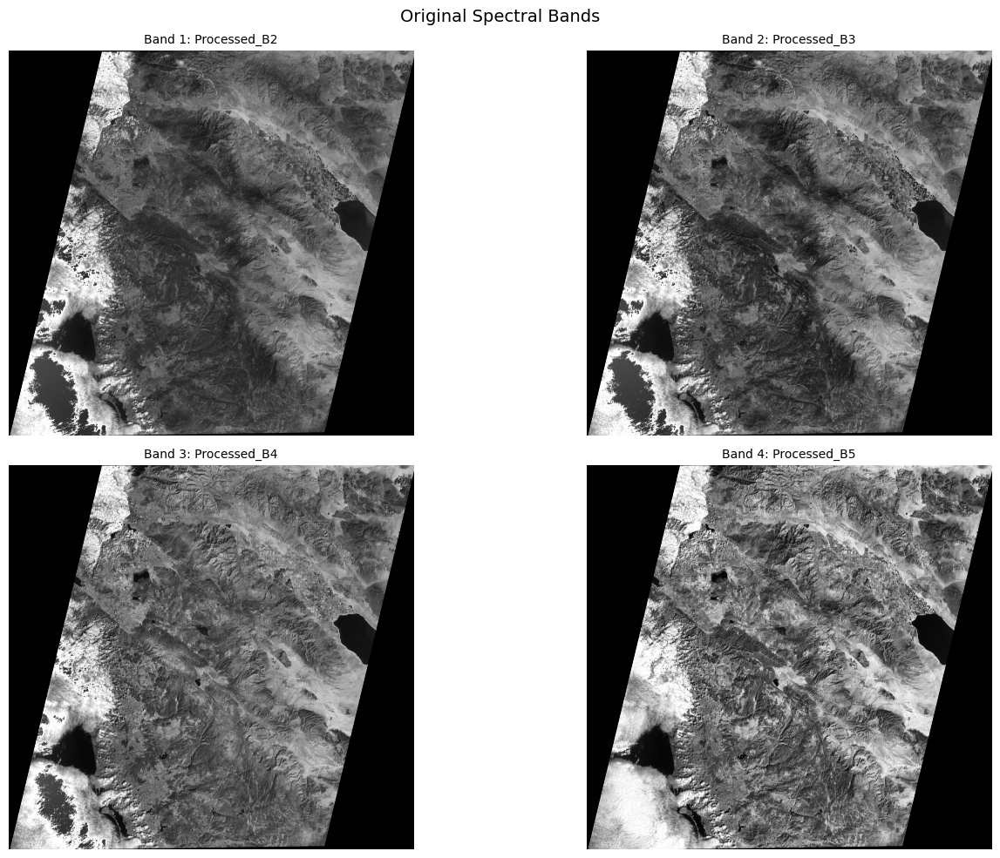

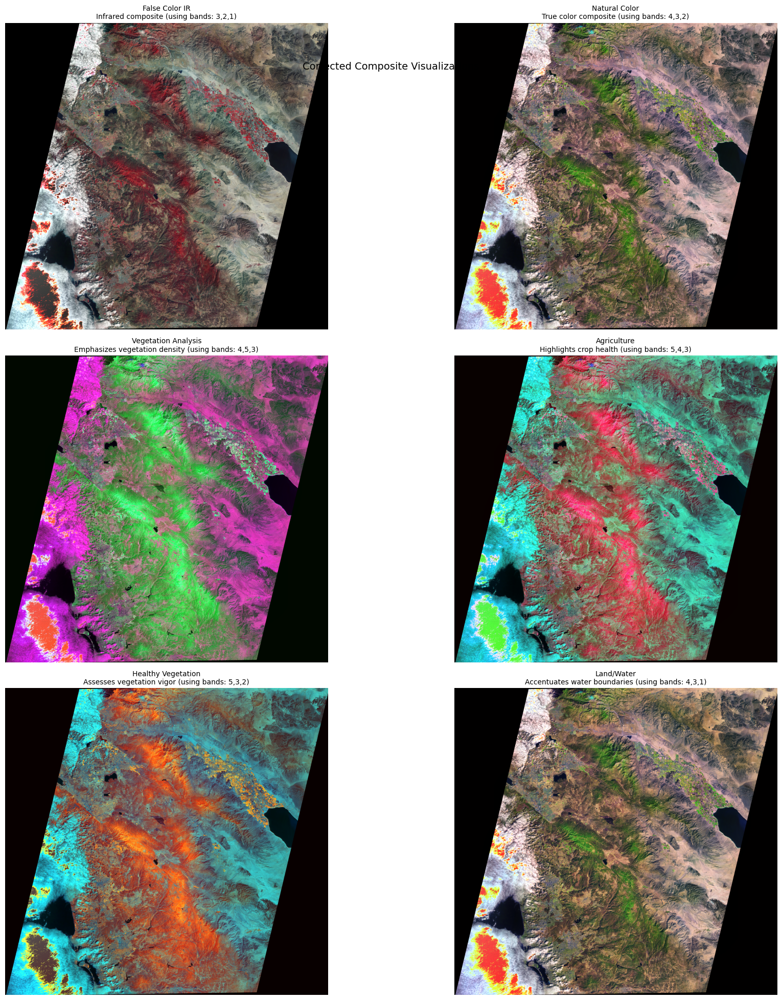

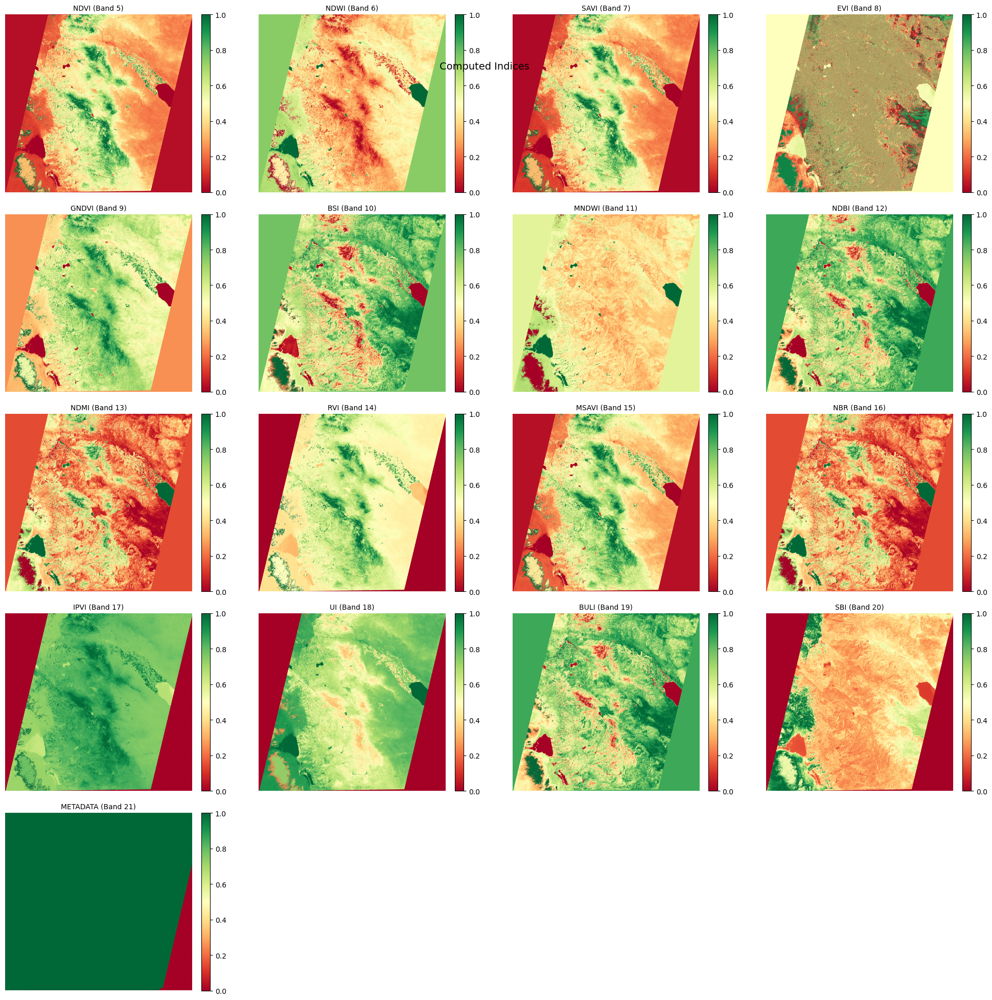

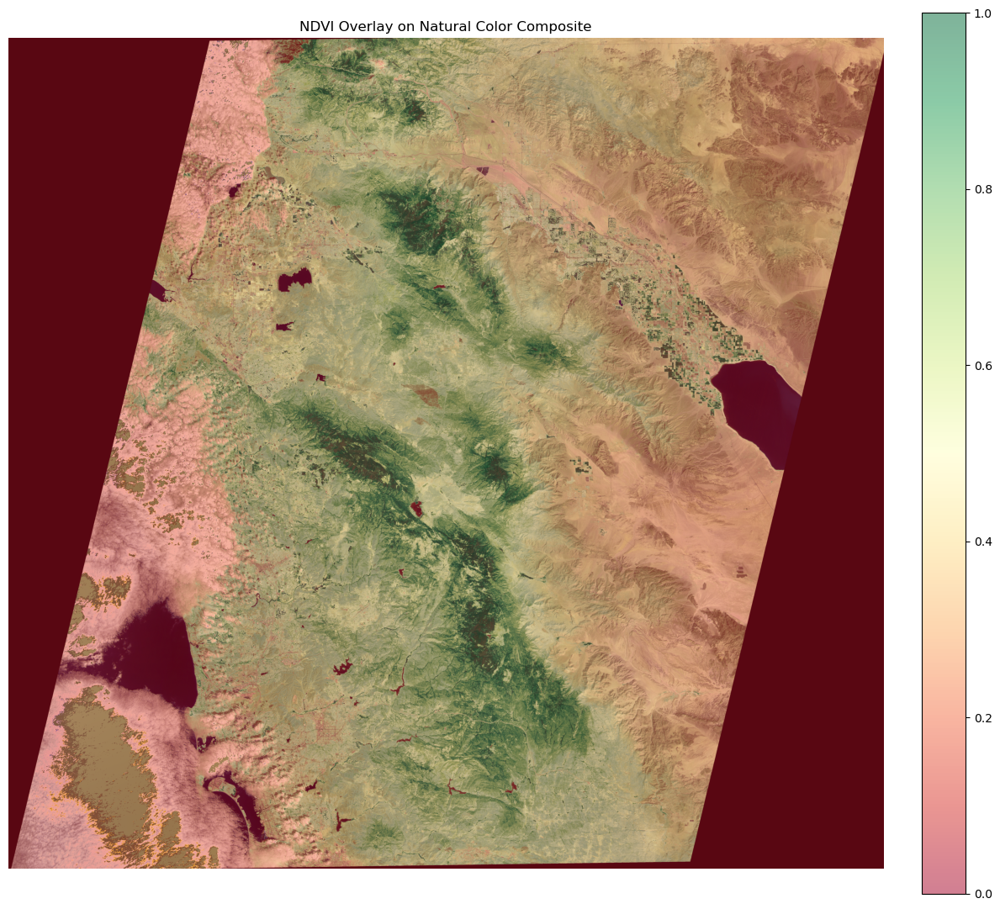

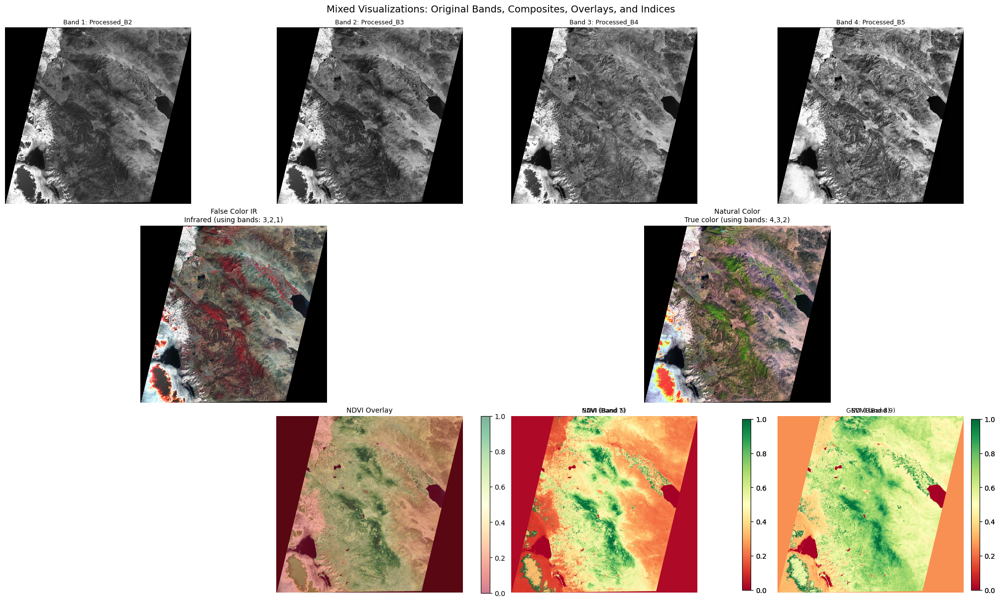

In [13]:
vis.plot_all()

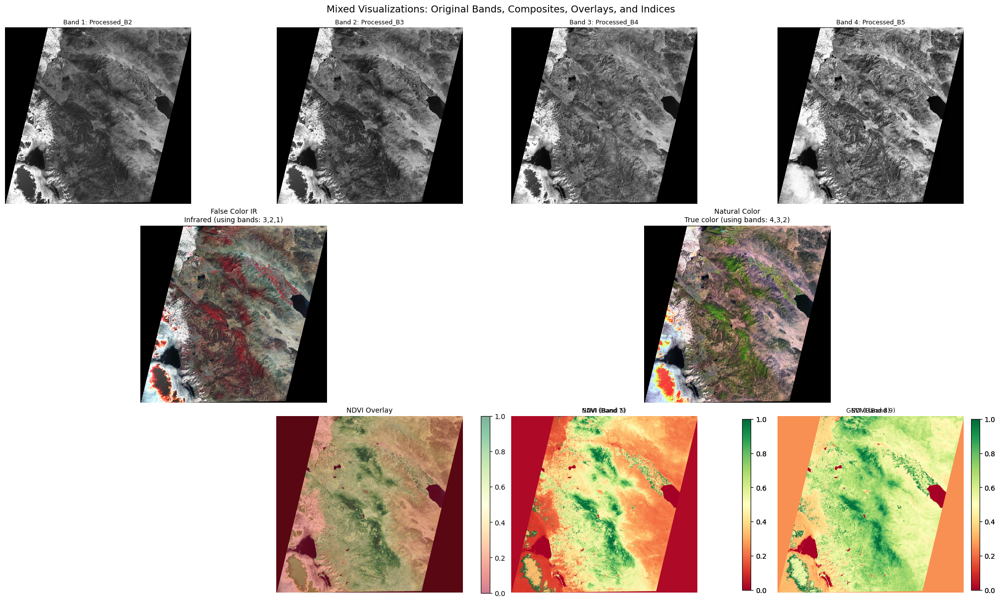

In [14]:
vis.plot_mixed_visualizations()

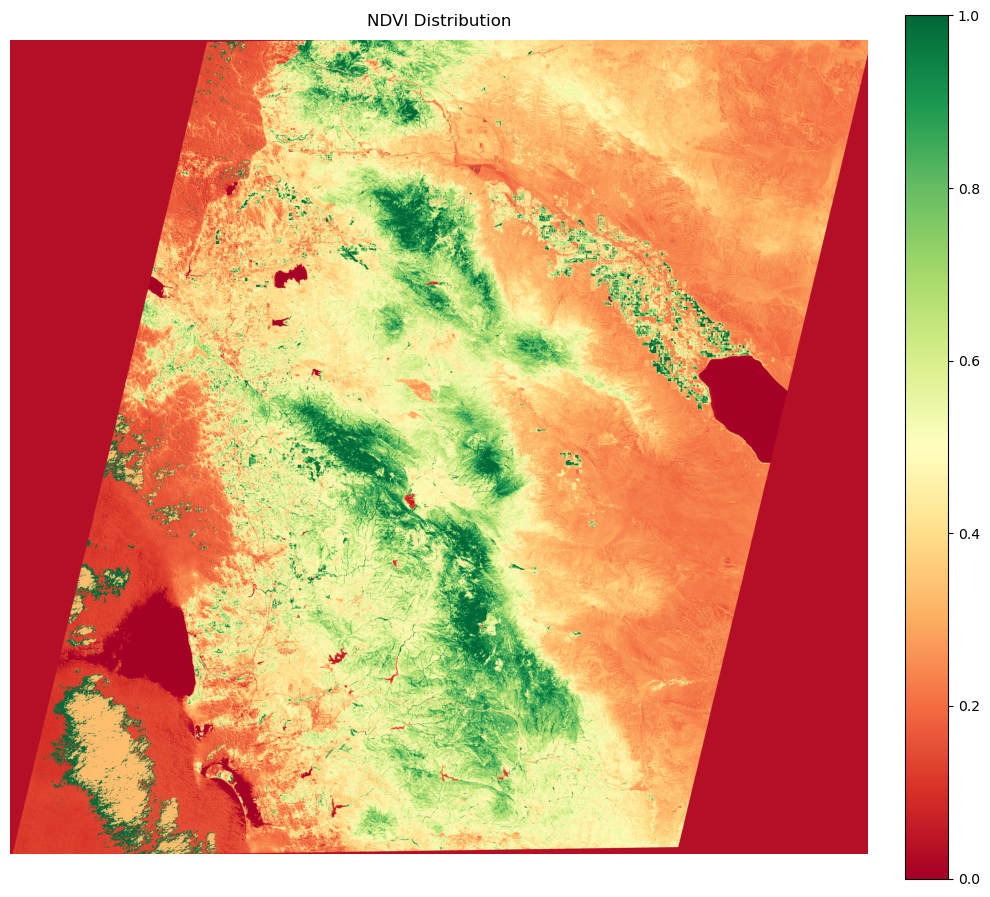

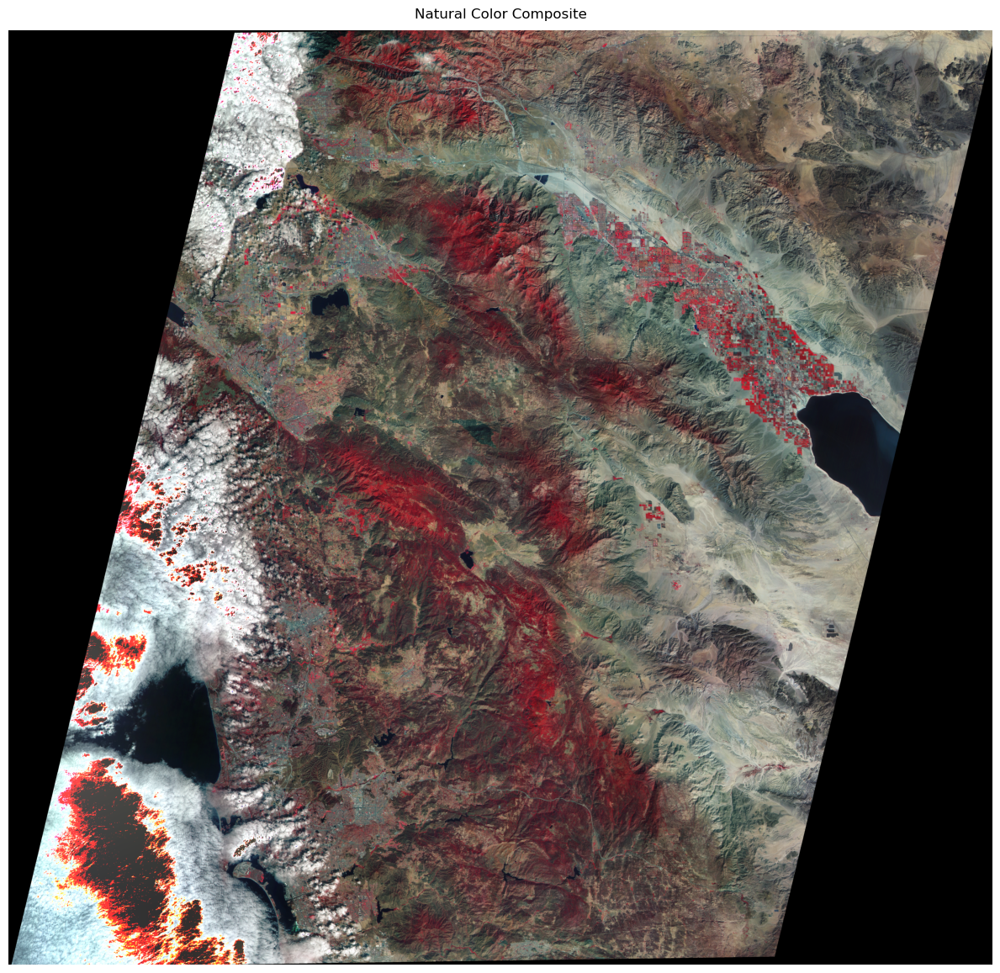

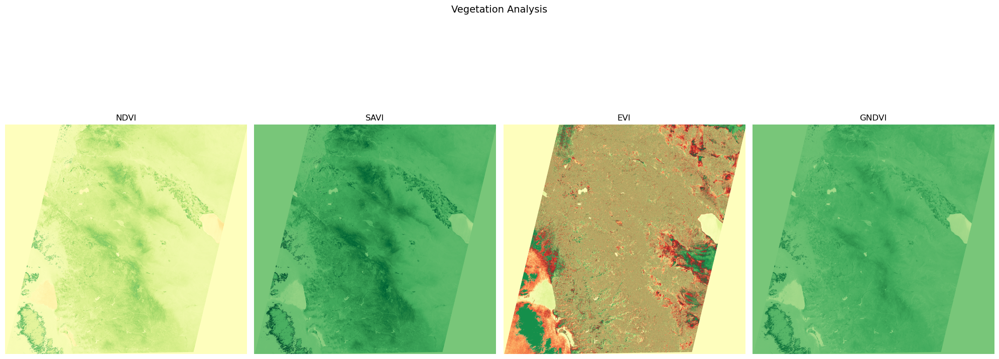

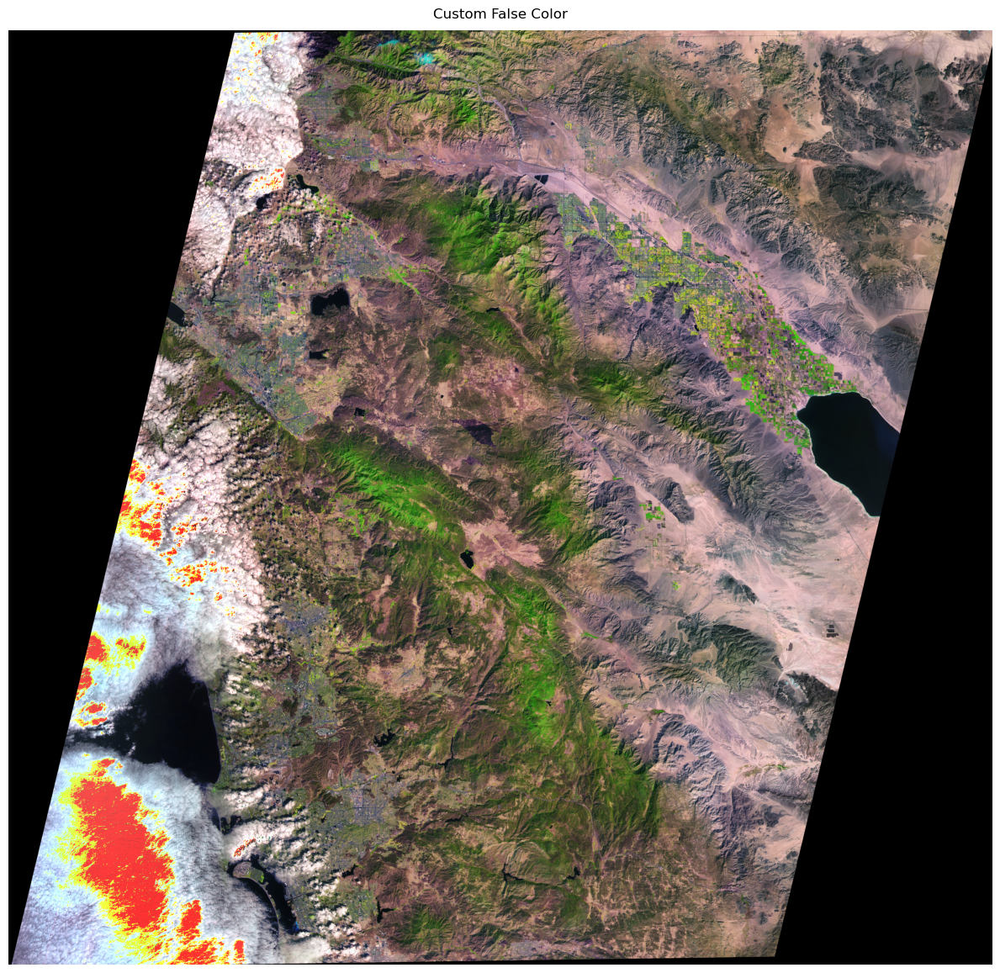

In [15]:
# Plot specific band (e.g., NDVI)
vis.plot_single_band(5, cmap='RdYlGn', title='NDVI Distribution')

# Plot RGB composite (Natural Color)
vis.plot_rgb_composite(3, 2, 1, title='Natural Color Composite')

# Plot vegetation analysis
vis.plot_vegetation_analysis()

# Create custom combination
vis.plot_rgb_composite(4, 3, 2, title='Custom False Color')

In [16]:
del vis
gc.collect()

99945

## 8.2 Classification Results Visualization Method

In [11]:
def visualize_classification_results(tif_path, labels, n_clusters):
    """Visualize final classification results with detailed analysis"""
    
    # Read original data
    with rasterio.open(tif_path) as src:
        # Natural color composite
        rgb = np.stack([src.read(i) for i in [3,2,1]])
        rgb = np.moveaxis(rgb, 0, -1)
        rgb = (rgb - rgb.min()) / (rgb.max() - rgb.min())
        
        # NDVI for comparison
        ndvi_idx = [i for i, desc in enumerate(src.descriptions, 1) 
                   if 'NDVI' in desc][0]
        ndvi = src.read(ndvi_idx)
    
    # Create figure with subplots
    fig = plt.figure(figsize=(20, 10))
    gs = fig.add_gridspec(2, 3)
    
    # Original image
    ax1 = fig.add_subplot(gs[0, 0])
    ax1.imshow(rgb)
    ax1.set_title('Original Image')
    ax1.axis('off')
    
    # NDVI
    ax2 = fig.add_subplot(gs[0, 1])
    im2 = ax2.imshow(ndvi, cmap='RdYlGn')
    ax2.set_title('NDVI')
    ax2.axis('off')
    plt.colorbar(im2, ax=ax2, fraction=0.046, pad=0.04)
    
    # Classification result
    ax3 = fig.add_subplot(gs[0, 2])
    im3 = ax3.imshow(labels, cmap='tab20')
    ax3.set_title('Classification Result')
    ax3.axis('off')
    plt.colorbar(im3, ax=ax3, fraction=0.046, pad=0.04)
    
    # Class distribution
    ax4 = fig.add_subplot(gs[1, 0])
    unique, counts = np.unique(labels, return_counts=True)
    ax4.bar(range(n_clusters), counts)
    ax4.set_title('Class Distribution')
    ax4.set_xlabel('Class')
    ax4.set_ylabel('Pixel Count')
    
    # Edge detection to show boundaries
    ax5 = fig.add_subplot(gs[1, 1])
    edges = cv2.Canny(labels.astype(np.uint8), 100, 200)
    ax5.imshow(edges, cmap='gray')
    ax5.set_title('Class Boundaries')
    ax5.axis('off')
    
    # Overlay of boundaries on original
    ax6 = fig.add_subplot(gs[1, 2])
    overlay = rgb.copy()
    overlay[edges > 0] = [1, 0, 0]  # Red boundaries
    ax6.imshow(overlay)
    ax6.set_title('Boundary Overlay')
    ax6.axis('off')
    
    plt.tight_layout()
    plt.show()


# 9. **Unsupervised Classification**: simple K Means

In [18]:
class LightweightClassifier:
    def __init__(self, n_clusters=5):
        self.n_clusters = n_clusters
    
    def _read_and_scale_features(self, tif_path):
        """Read specific bands and indices efficiently"""
        with rasterio.open(tif_path) as src:
            # Get a subset of bands to reduce memory usage
            # Use only B4 (NIR), B3 (Red) and NDVI
            bands = []
            # Green, NIR and Red bands
            for band_idx in [2, 3, 4]:  # Green, Red and NIR
                band = src.read(band_idx)
                bands.append(band)
            
            # Find and add NDVI
            try:
                ndvi_idx = [i for i, desc in enumerate(src.descriptions, 1) 
                           if 'NDVI' in desc][0]
                bands.append(src.read(ndvi_idx))
            except:
                print("Warning: NDVI band not found")
            
            self.original_shape = bands[0].shape
            
            # Stack and reshape
            X = np.stack(bands, axis=0)
            X = X.reshape(X.shape[0], -1).T
            
            # Scale features
            scaler = StandardScaler()
            X_scaled = scaler.fit_transform(X)
            
            # Clean up
            del bands
            gc.collect()
            
            return X_scaled
    
    def _cluster_data(self, X):
        """Perform clustering with K-means only for simplicity"""
        kmeans = KMeans(n_clusters=self.n_clusters, random_state=42)
        labels = kmeans.fit_predict(X)
        return labels
    
    def _spatial_refinement(self, labels_2d):
        """Basic spatial refinement"""
        return ndimage.median_filter(labels_2d, size=3)
    
    def fit_predict(self, tif_path):
        """Main clustering method with memory efficient processing"""
        print("Reading and scaling features...")
        X_scaled = self._read_and_scale_features(tif_path)
        
        print("\nPerforming initial clustering...")
        labels = self._cluster_data(X_scaled)
        labels_2d = labels.reshape(self.original_shape)
        
        # Clean up feature data
        del X_scaled
        gc.collect()
        
        # Single refinement pass
        print("\nRefining results...")
        refined_labels = self._spatial_refinement(labels_2d)
        
        # Visualize result
        print("\nGenerating visualization...")
        visualize_classification_results(tif_path, refined_labels, self.n_clusters)
        
        return refined_labels

Reading and scaling features...

Performing initial clustering...

Refining results...

Generating visualization...


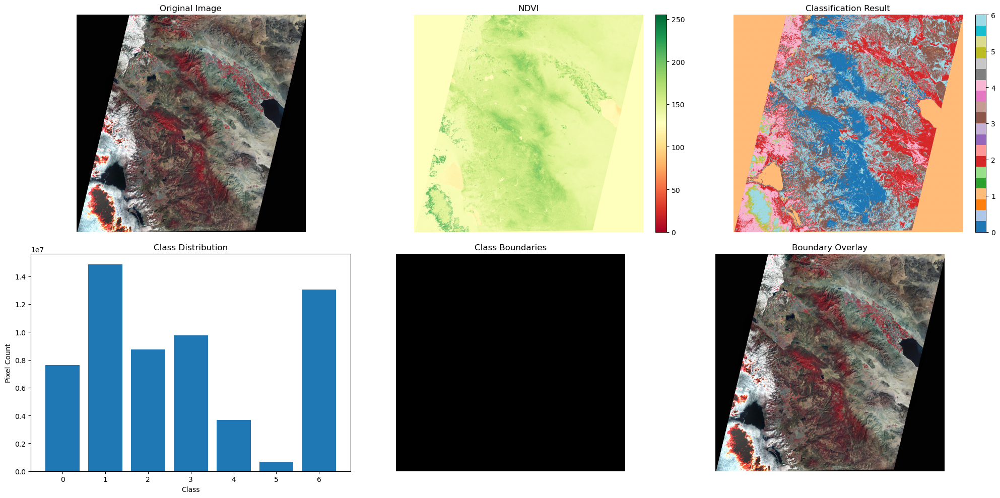

22687

In [19]:
N_C = 7
classifier = LightweightClassifier(n_clusters=N_C)
final_labels = classifier.fit_predict(tif_file_path)
del classifier, final_labels
gc.collect()

Reading and scaling features...

Performing initial clustering...

Refining results...

Generating visualization...


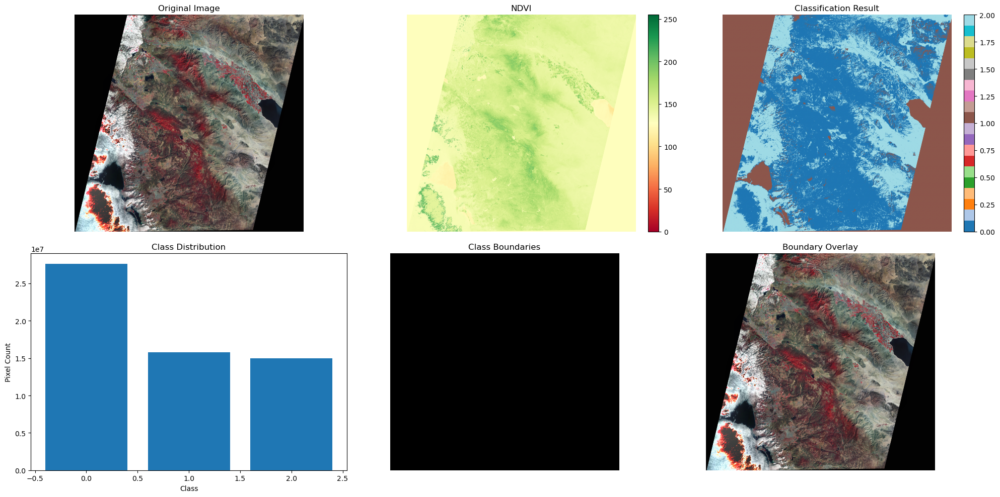

22471

In [20]:
N_C = 3
classifier = LightweightClassifier(n_clusters=N_C)
final_labels = classifier.fit_predict(tif_file_path)
del classifier, final_labels
gc.collect()

Reading and scaling features...

Performing initial clustering...

Refining results...

Generating visualization...


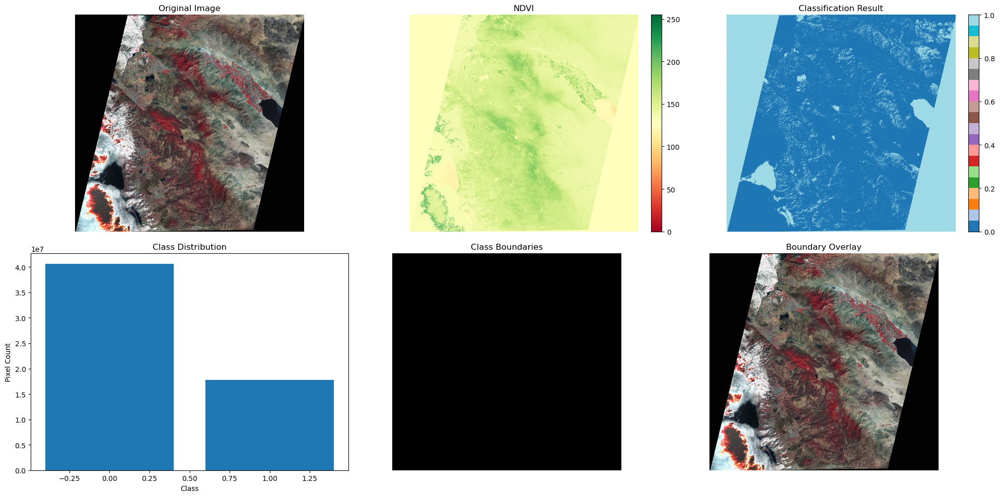

22406

In [21]:
N_C = 2
classifier = LightweightClassifier(n_clusters=N_C)
final_labels = classifier.fit_predict(tif_file_path)
del classifier, final_labels
gc.collect()

# 10. **Unsupervised Classification**: MiniBatch KMeans X DBSCAN

In [22]:
##############################################
# Helper: Mini-batch DBSCAN (multi-threaded)
##############################################
def mini_batch_dbscan(X, eps, min_samples, sample_fraction=0.1):
    """
    A mini-batch version of DBSCAN:
      - Randomly samples a subset of points (of size = sample_fraction * n)
      - Runs DBSCAN on the sample (using n_jobs=-1 for multi-threading)
      - For each point in X, assigns the label of its nearest sample point if within eps;
        otherwise, marks it as noise (-1).
    """
    n_samples = X.shape[0]
    sample_size = max(min_samples, int(n_samples * sample_fraction))
    sample_indices = np.random.choice(n_samples, sample_size, replace=False)
    X_sample = X[sample_indices]
    db = DBSCAN(eps=eps, min_samples=min_samples, n_jobs=-1)
    sample_labels = db.fit_predict(X_sample)
    nbrs = NearestNeighbors(n_neighbors=1, n_jobs=-1).fit(X_sample)
    distances, indices_nn = nbrs.kneighbors(X)
    labels = np.full(n_samples, -1, dtype=int)
    for i in range(n_samples):
        if distances[i, 0] < eps:
            labels[i] = sample_labels[indices_nn[i, 0]]
    return labels

##############################################
# Advanced Chunked Classification Pipeline
##############################################
class AdvancedChunkedClassifier:
    def __init__(self,
                 chunk_size=128,
                 overlap=32,
                 k_init=10,
                 iterative_iterations=1,
                 dbscan_eps=0.5,
                 dbscan_min_samples=10,
                 dbscan_sample_fraction=0.1,
                 feature_bands=None,
                 tmp_dir="tmp_chunks"):
        """
        :param chunk_size: Size (in pixels) of square chunks.
        :param overlap: Overlap (in pixels) between adjacent chunks.
        :param k_init: Number of clusters for the global MiniBatchKMeans partial fit.
        :param iterative_iterations: Number of iterative refinement rounds.
        :param dbscan_eps: DBSCAN epsilon.
        :param dbscan_min_samples: DBSCAN min_samples.
        :param dbscan_sample_fraction: Fraction of points to sample for mini-batch DBSCAN.
        :param feature_bands: List of 1-based band indices to use (default: [1,2,3,4]).
        :param tmp_dir: Directory to offload chunk results.
        """
        self.chunk_size = chunk_size
        self.overlap = overlap
        self.k_init = k_init
        self.iterative_iterations = iterative_iterations
        self.dbscan_eps = dbscan_eps
        self.dbscan_min_samples = dbscan_min_samples
        self.dbscan_sample_fraction = dbscan_sample_fraction
        self.feature_bands = feature_bands if feature_bands is not None else [1, 2, 3, 4]
        self.tmp_dir = tmp_dir
        if os.path.exists(self.tmp_dir):
            shutil.rmtree(self.tmp_dir)
        os.makedirs(self.tmp_dir)
    
    def _find_ndvi_idx(self, src):
        for i, desc in enumerate(src.descriptions, start=1):
            if desc and 'NDVI' in desc.upper():
                return i
        return None
    
    def _read_features_chunk(self, src, window):
        """
        Reads the bands specified in self.feature_bands (plus NDVI if available)
        for the given window. Returns an array of shape (n_features, H, W).
        """
        bands = []
        for b in self.feature_bands:
            band_data = src.read(b, window=window)
            bands.append(band_data)
        ndvi_idx = self._find_ndvi_idx(src)
        if ndvi_idx:
            try:
                ndvi_data = src.read(ndvi_idx, window=window)
                bands.append(ndvi_data)
            except Exception as e:
                print("Warning: Could not read NDVI band:", e)
        return np.stack(bands, axis=0)
    
    def _global_partial_fit_pass(self, tif_path):
        """
        Step 1: In two passes, gather random samples (with overlap) to fit a global
        StandardScaler and then partially fit a MiniBatchKMeans to learn global cluster centers.
        """
        print("=== Global Partial-Fit Pass ===")
        with rasterio.open(tif_path) as src:
            H, W = src.height, src.width
            step = self.chunk_size - self.overlap
            sample_list = []
            for row in range(0, H, step):
                for col in range(0, W, step):
                    win_h = min(self.chunk_size, H - row)
                    win_w = min(self.chunk_size, W - col)
                    window = rasterio.windows.Window(col, row, win_w, win_h)
                    feats = self._read_features_chunk(src, window)
                    n_feats = feats.shape[0]
                    arr_2d = feats.reshape(n_feats, -1).T
                    del feats
                    gc.collect()
                    if arr_2d.shape[0] > 500:
                        sample_inds = np.random.choice(arr_2d.shape[0], 500, replace=False)
                        sample_list.append(arr_2d[sample_inds, :])
                    else:
                        sample_list.append(arr_2d)
                    del arr_2d
                    gc.collect()
            all_samples = np.vstack(sample_list) if sample_list else None
            if all_samples is None or all_samples.shape[0] == 0:
                raise ValueError("No samples collected for scaling!")
            scaler = StandardScaler()
            scaler.fit(all_samples)
            del all_samples, sample_list
            gc.collect()
            
            mbk = MiniBatchKMeans(n_clusters=self.k_init, random_state=42, batch_size=2048)
            with rasterio.open(tif_path) as src2:
                for row in range(0, H, step):
                    for col in range(0, W, step):
                        win_h = min(self.chunk_size, H - row)
                        win_w = min(self.chunk_size, W - col)
                        window = rasterio.windows.Window(col, row, win_w, win_h)
                        feats = self._read_features_chunk(src2, window)
                        arr_2d = feats.reshape(feats.shape[0], -1).T
                        del feats
                        gc.collect()
                        arr_2d = scaler.transform(arr_2d)
                        mbk.partial_fit(arr_2d)
                        del arr_2d
                        gc.collect()
            self.global_centers_ = mbk.cluster_centers_
            self.global_scaler_ = scaler
            print("Global centers obtained:", self.global_centers_.shape[0])
    
    def _process_chunk(self, feats_2d):
        """
        Process a chunk’s pixel features (already scaled) by:
          - Running our mini-batch DBSCAN (multi-threaded) on feats_2d.
          - One-hot encoding the non-noise DBSCAN labels.
          - Augmenting the original features with these one-hot columns.
          - Running a local MiniBatchKMeans (with n_clusters from the global pass).
          - Returning the 1D label array.
        """
        n_pixels = feats_2d.shape[0]
        db_labels = mini_batch_dbscan(feats_2d, eps=self.dbscan_eps, 
                                      min_samples=self.dbscan_min_samples,
                                      sample_fraction=self.dbscan_sample_fraction)
        unique_db = np.unique(db_labels)
        mapping = {}
        c_index = 0
        for lb in unique_db:
            if lb != -1:
                mapping[lb] = c_index
                c_index += 1
        one_hot_db = np.zeros((n_pixels, len(mapping)))
        for i, lb in enumerate(db_labels):
            if lb in mapping:
                one_hot_db[i, mapping[lb]] = 1
        augmented = np.hstack([feats_2d, one_hot_db])
        del one_hot_db, db_labels
        gc.collect()
        n_clusters = self.global_centers_.shape[0]
        loc_mbk = MiniBatchKMeans(n_clusters=n_clusters, random_state=42, batch_size=1024)
        loc_mbk.fit(augmented)
        chunk_labels = loc_mbk.predict(augmented).astype(np.int32)
        del augmented
        gc.collect()
        return chunk_labels
    
    def _process_and_offload_chunk(self, src, window, row, col):
        """
        Process one chunk: read its features, scale them, run local clustering,
        apply a median filter, and offload the resulting label mask to disk.
        """
        feats = self._read_features_chunk(src, window)
        h, w = feats.shape[1], feats.shape[2]
        n_feats = feats.shape[0]
        arr_2d = feats.reshape(n_feats, -1).T
        del feats
        gc.collect()
        arr_2d = self.global_scaler_.transform(arr_2d)
        chunk_labels_1d = self._process_chunk(arr_2d)
        del arr_2d
        gc.collect()
        label_mask = chunk_labels_1d.reshape(h, w)
        label_mask = ndimage.median_filter(label_mask, size=3)
        fname = os.path.join(self.tmp_dir, f"chunk_{row}_{col}.npy")
        np.save(fname, label_mask)
        del label_mask, chunk_labels_1d
        gc.collect()
    
    def _process_all_chunks(self, tif_path):
        """
        Loop over the image in overlapping chunks and offload each chunk's
        label mask to disk.
        """
        with rasterio.open(tif_path) as src:
            H, W = src.height, src.width
            step = self.chunk_size - self.overlap
            for row in range(0, H, step):
                for col in range(0, W, step):
                    win_h = min(self.chunk_size, H - row)
                    win_w = min(self.chunk_size, W - col)
                    window = rasterio.windows.Window(col, row, win_w, win_h)
                    print(f"Processing window at row {row}, col {col}, size ({win_h}, {win_w})")
                    self._process_and_offload_chunk(src, window, row, col)
                    gc.collect()
    
    def _merge_offloaded_chunks(self, tif_path):
        """
        Merge all offloaded chunk label masks (which overlap) using a voting scheme.
        For each pixel, all votes from overlapping chunks are collected and the mode is taken.
        """
        with rasterio.open(tif_path) as src:
            H, W = src.height, src.width
        votes = np.empty((H, W), dtype=object)
        for i in range(H):
            for j in range(W):
                votes[i, j] = []
        step = self.chunk_size - self.overlap
        for row in range(0, H, step):
            for col in range(0, W, step):
                fname = os.path.join(self.tmp_dir, f"chunk_{row}_{col}.npy")
                if os.path.exists(fname):
                    chunk_labels = np.load(fname)
                    win_h, win_w = chunk_labels.shape
                    for i in range(win_h):
                        for j in range(win_w):
                            votes[row + i, col + j].append(chunk_labels[i, j])
                    del chunk_labels
                    gc.collect()
        final_mask = np.zeros((H, W), dtype=np.int32)
        for i in range(H):
            for j in range(W):
                if len(votes[i, j]) > 0:
                    mode_result = mode(np.array(votes[i, j], dtype=np.int32), keepdims=True)
                    final_mask[i, j] = mode_result.mode[0] if hasattr(mode_result, "mode") else mode_result
                else:
                    final_mask[i, j] = 0
        return final_mask
    
    def fit_predict(self, tif_path):
        """
        Full pipeline:
          1. Global partial_fit pass to compute the scaler and global cluster centers.
          2. Process all overlapping chunks (offloading each chunk’s label mask to disk).
          3. Merge the offloaded chunk results (via vote accumulation) to yield a final mask.
          4. Optionally apply a final median filter.
          5. Clean up temporary files.
        Returns the final 2D classification mask.
        """
        self._global_partial_fit_pass(tif_path)
        self._process_all_chunks(tif_path)
        print("Merging offloaded chunk results...")
        final_mask = self._merge_offloaded_chunks(tif_path)
        print("Applying final smoothing...")
        final_mask = ndimage.median_filter(final_mask, size=3)
        shutil.rmtree(self.tmp_dir)
        return final_mask

In [13]:
##############################################
# Example Usage (Jupyter Notebook Cell)
##############################################
# Uncomment and modify the path below as needed:
classifier = AdvancedChunkedClassifier(
    chunk_size=384,
    overlap=256,
    k_init=3,
    iterative_iterations=1,
    dbscan_eps=0.5,
    dbscan_min_samples=10,
    dbscan_sample_fraction=0.1
)
final_labels = classifier.fit_predict(tif_file_path)
n_clusters_final = len(np.unique(final_labels))
visualize_classification_results(tif_file_path, final_labels, n_clusters_final)

=== Global Partial-Fit Pass ===
Global centers obtained: 3
Processing window at row 0, col 0, size (384, 384)
Processing window at row 0, col 128, size (384, 384)0, col 0, size (384, 384)

256, size (384, 384)0, col 0, size (384, 384)


Processing window at row 0, col 384, size (384, 384)
512, size (384, 384)

Processing window at row 0, col 640, size (384, 384)
768, size (384, 384)

Processing window at row 0, col 896, size (384, 384)
1024, size (384, 384)
Processing window at row 0, col 1152, size (384, 384)
280, size (384, 384)

Processing window at row 0, col 1408, size (384, 384)
536, size (384, 384)

Processing window at row 0, col 1664, size (384, 384)
792, size (384, 384)

Processing window at row 0, col 1920, size (384, 384)
2048, size (384, 384)

Processing window at row 0, col 2176, size (384, 384)
304, size (384, 384)

Processing window at row 0, col 2432, size (384, 384)
560, size (384, 384)

Processing window at row 0, col 2688, size (384, 384)
816, size (384, 384)

Proce

KeyboardInterrupt: 

In [18]:
del classifier, final_labels
gc.collect()

1495

# 11. **Supervised Classifier**: Using SAM/Clip with UC Merced Dataset

In [12]:
#!/usr/bin/env python
# coding: utf-8
"""
Full Pipeline: Fine-Tuning a SAM-Based Segmentation Classifier for UC Merced Land Use 
and Applying It on LISS3 Swath Data with Spatial Continuity Loss and WandB Logging.

Requirements:
  - UC Merced Land Use dataset organized as:
       ./data/UCMerced_LandUse/UCMerced_LandUse/Images/<class_name>/*.tif (or .png/.tif)
  - A processed LISS3 swath TIF (georeferenced) available via the variable `tif_file_path`
  - SAM checkpoint file at "./sam_vit_h_4b8939.pth"
  - Necessary packages installed (torch, clip-by-openai, segment-anything, wandb, etc.)

The model is fine-tuned on UCMerced images (256×256 RGB) with a segmentation target (each pixel set to the image’s class). 
A total variation (TV) loss is added for spatial continuity. At inference time, a sliding-window approach is applied 
to a swath RGB composite (using any of the first 20 bands) to produce a pixel-wise classification mask. Two GeoTIFFs are saved:
  (1) a swath image file (using the main 4 bands) and 
  (2) a classification mask file (with one band per class, one-hot encoded).
  
This code contains:
  • A custom PyTorch Dataset for UCMerced,
  • A SAM-based segmentation model with proper interpolation of positional embeddings,
  • A Trainer class that supports training, evaluation, inference, saving/loading, and wandb logging,
  • A sliding-window inference function,
  • GeoTIFF saving functions.
  
No placeholders remain.
"""
#############################################
# Loss: Total Variation Loss for Spatial Continuity
#############################################
class TotalVariationLoss(nn.Module):
    def __init__(self):
        super(TotalVariationLoss, self).__init__()
    def forward(self, x):
        # x: (B, C, H, W)
        loss = torch.sum(torch.abs(x[:, :, :, :-1] - x[:, :, :, 1:])) + torch.sum(torch.abs(x[:, :, :-1, :] - x[:, :, 1:, :]))
        return loss

#############################################
# Helper: Interpolate Positional Embedding (without using encoder.patch_embed.grid_size)
#############################################
def interpolate_pos_embed(pos_embed, new_H, new_W):
    """
    Interpolates a positional embedding from its original grid to a new grid.
    Assumes pos_embed is of shape (1, L+1, D), where the first token is a class token.
    Computes original grid size as sqrt(L).
    """
    import math
    cls_token = pos_embed[:, :1, :]       # (1, 1, D)
    pos_embed_only = pos_embed[:, 1:, :]    # (1, L, D)
    L = pos_embed_only.shape[1]
    H_old = W_old = int(round(math.sqrt(L)))
    assert H_old * W_old == L, "Mismatch in computed grid dimensions"
    D = pos_embed_only.shape[2]
    pos_embed_only = pos_embed_only.reshape(1, H_old, W_old, D).permute(0, 3, 1, 2)  # (1, D, H_old, W_old)
    pos_embed_only = torch.nn.functional.interpolate(pos_embed_only, size=(new_H, new_W), mode='bicubic', align_corners=False)
    pos_embed_only = pos_embed_only.permute(0, 2, 3, 1).reshape(1, new_H * new_W, D)
    new_pos_embed = torch.cat([cls_token, pos_embed_only], dim=1)
    return new_pos_embed

#############################################
# Trainer Class for Fine-Tuning and Evaluation
#############################################
class SAMClassifierTrainer:
    def __init__(self, model, train_loader, val_loader=None, lr=1e-4, weight_decay=1e-5, use_wandb=False, wandb_project="SAMClassifier"):
        self.model = model.to(device)
        self.train_loader = train_loader
        self.val_loader = val_loader
        self.criterion = nn.CrossEntropyLoss()  # pixel-wise loss
        self.tv_loss = TotalVariationLoss()
        self.optimizer = optim.Adam(self.model.parameters(), lr=lr, weight_decay=weight_decay)
        self.use_wandb = use_wandb
        if self.use_wandb:
            wandb.init(project=wandb_project, config={"lr": lr, "weight_decay": weight_decay})
            wandb.watch(self.model)
    def train_epoch(self, epoch):
        self.model.train()
        running_loss = 0.0
        for i, (images, masks) in enumerate(self.train_loader):
            images = images.to(device)
            masks = masks.to(device)
            self.optimizer.zero_grad()
            logits = self.model(images)
            loss_ce = self.criterion(logits, masks)
            loss_tv = self.tv_loss(nn.functional.softmax(logits, dim=1))
            loss = loss_ce + 0.1 * loss_tv
            loss.backward()
            self.optimizer.step()
            running_loss += loss.item()
            if self.use_wandb:
                wandb.log({"batch_loss": loss.item()})
        epoch_loss = running_loss / len(self.train_loader)
        print(f"Epoch {epoch}: Training loss = {epoch_loss:.4f}")
        if self.use_wandb:
            wandb.log({"epoch_train_loss": epoch_loss, "epoch": epoch})
        return epoch_loss
    def evaluate(self):
        self.model.eval()
        running_loss = 0.0
        total_pixels = 0
        correct_pixels = 0
        with torch.no_grad():
            for images, masks in self.val_loader:
                images = images.to(device)
                masks = masks.to(device)
                logits = self.model(images)
                loss = self.criterion(logits, masks)
                running_loss += loss.item()
                preds = torch.argmax(logits, dim=1)
                total_pixels += masks.numel()
                correct_pixels += (preds == masks).sum().item()
        val_loss = running_loss / len(self.val_loader)
        accuracy = correct_pixels / total_pixels
        print(f"Validation loss = {val_loss:.4f}, Accuracy = {accuracy:.4f}")
        if self.use_wandb:
            wandb.log({"val_loss": val_loss, "val_accuracy": accuracy})
        return val_loss, accuracy
    def train(self, num_epochs):
        for epoch in range(1, num_epochs+1):
            self.train_epoch(epoch)
            if self.val_loader is not None:
                self.evaluate()
    def infer(self, image_tensor):
        self.model.eval()
        with torch.no_grad():
            logits = self.model(image_tensor.to(device))
            preds = torch.argmax(logits, dim=1)
        return preds.cpu().squeeze(0).numpy()
    def save_model(self, path):
        self.model.save(path)
    def load_model(self, path):
        self.model.load(path)

#############################################
# Sliding-Window Inference on Swath Data
#############################################
def sliding_window_inference(model, rgb_image, window_size=256, stride=256):
    model.eval()
    H, W, _ = rgb_image.shape
    pred_mask = np.zeros((H, W), dtype=np.int32)
    count_mask = np.zeros((H, W), dtype=np.float32)
    transform_img = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize((0.48145466, 0.4578275, 0.40821073),
                             (0.26862954, 0.26130258, 0.27577711))
    ])
    with torch.no_grad():
        for i in range(0, H, stride):
            for j in range(0, W, stride):
                window = rgb_image[i:min(i+window_size, H), j:min(j+window_size, W), :]
                h_win, w_win, _ = window.shape
                if h_win != window_size or w_win != window_size:
                    padded = np.zeros((window_size, window_size, 3), dtype=np.uint8)
                    padded[:h_win, :w_win, :] = window
                    window = padded
                img_tensor = transform_img(Image.fromarray(window)).unsqueeze(0).to(device)
                logits = model(img_tensor)
                pred = torch.argmax(logits, dim=1).squeeze(0).cpu().numpy()
                pred = pred[:h_win, :w_win]
                pred_mask[i:i+h_win, j:j+w_win] += pred
                count_mask[i:i+h_win, j:j+w_win] += 1
    final_pred = np.rint(pred_mask / count_mask).astype(np.int32)
    return final_pred

#############################################
# Save Results as GeoTIFFs
#############################################
def save_geotiff(swath_tif, classification_mask, output_path, num_classes):
    with rasterio.open(swath_tif) as src:
        profile = src.profile.copy()
        swath_main = src.read([1,2,3,4])
    swath_out = os.path.splitext(output_path)[0] + "_swath.tif"
    profile.update({"count": 4, "dtype": swath_main.dtype})
    with rasterio.open(swath_out, "w", **profile) as dst:
        dst.write(swath_main)
    print("Swath image saved to:", swath_out)
    
    H, W = classification_mask.shape
    one_hot = np.zeros((num_classes, H, W), dtype=np.uint8)
    for c in range(num_classes):
        one_hot[c] = (classification_mask == c).astype(np.uint8) * 255
    mask_profile = profile.copy()
    mask_profile.update({"count": num_classes, "dtype": one_hot.dtype})
    mask_out = os.path.splitext(output_path)[0] + "_mask.tif"
    with rasterio.open(mask_out, "w", **mask_profile) as dst:
        dst.write(one_hot)
    print("Classification mask saved to:", mask_out)

def get_aligned_pos_embed(encoder, x_tokens):
    """
    Given encoder.pos_embed and the tokens x_tokens from the patch_embed,
    return a positional embedding tensor of shape (1, L_new, D), where
    L_new matches the number of tokens in x_tokens.
    This function handles cases where encoder.pos_embed is stored as either:
      - a 3D tensor of shape (1, L_original, D), or 
      - a 4D tensor of shape (1, C, H_original, W_original).
    If L_original does not match the desired L_new, it performs bicubic interpolation.
    """
    L_new = x_tokens.shape[1]  # desired number of tokens (e.g., 4096 for 1024×1024 input with 16×16 patches)
    pos_embed = encoder.pos_embed  # may be of shape (1, L_original+1, D) or (1, 1, H_original, W_original)
    # If pos_embed is 4D, squeeze and reshape it.
    if pos_embed.dim() == 4:
        # Assume shape is (1, C, H_original, W_original); squeeze dimension 1.
        pos_embed = pos_embed.squeeze(1)  # now (1, H_original, W_original, D)
        pos_embed = pos_embed.reshape(1, -1, pos_embed.shape[-1])  # (1, L_original, D)
    # Check if a class token is included (assume if L >= L_new+1, the first token is class token).
    if pos_embed.shape[1] == L_new + 1:
        # Remove the class token.
        pos_embed_patch = pos_embed[:, 1:, :]  # (1, L_original, D) with L_original == L_new
        return pos_embed_patch
    elif pos_embed.shape[1] == L_new:
        return pos_embed
    else:
        # We assume pos_embed includes a class token and its remaining tokens form a square grid.
        # Remove the class token if present.
        if pos_embed.shape[1] == L_new + 1:
            pos_embed_patch = pos_embed[:, 1:, :]
        else:
            pos_embed_patch = pos_embed
        L_orig = pos_embed_patch.shape[1]
        H_orig = W_orig = int(round(math.sqrt(L_orig)))
        assert H_orig * W_orig == L_orig, "Original positional embedding does not form a perfect square grid"
        # Reshape to (1, D, H_orig, W_orig)
        D = pos_embed_patch.shape[-1]
        pos_embed_patch = pos_embed_patch.reshape(1, H_orig, W_orig, D).permute(0, 3, 1, 2)
        # Determine new grid size from x_tokens.
        new_H = new_W = int(round(math.sqrt(L_new)))
        # Interpolate
        pos_embed_interp = torch.nn.functional.interpolate(pos_embed_patch, size=(new_H, new_W), mode='bicubic', align_corners=False)
        pos_embed_interp = pos_embed_interp.permute(0, 2, 3, 1).reshape(1, new_H * new_W, D)
        return pos_embed_interp


In [13]:
#############################################
# (New Configuration)
#############################################
TRAIN_IMG_SIZE = (1024, 1024)
INFER_WINDOW_SIZE = 1024

#############################################
# UCMerced Dataset Loader (resizing images to 1024×1024)
#############################################
class UCMercedDataset1024(Dataset):
    def __init__(self, root_dir, transform=None):
        self.samples = []
        self.transform = transform
        classes = sorted([d for d in os.listdir(root_dir) if os.path.isdir(os.path.join(root_dir, d))])
        self.classes = classes
        self.class_to_idx = {cls_name: idx for idx, cls_name in enumerate(classes)}
        for cls in classes:
            cls_dir = os.path.join(root_dir, cls)
            for fname in os.listdir(cls_dir):
                if fname.lower().endswith((".jpg", ".jpeg", ".png", ".tif")):
                    self.samples.append((os.path.join(cls_dir, fname), self.class_to_idx[cls]))
    def __len__(self):
        return len(self.samples)
    def __getitem__(self, idx):
        img_path, label = self.samples[idx]
        image = Image.open(img_path).convert("RGB")
        image = image.resize(TRAIN_IMG_SIZE)
        if self.transform is not None:
            image = self.transform(image)
        else:
            transform_default = transforms.Compose([
                transforms.ToTensor(),
                transforms.Normalize((0.48145466, 0.4578275, 0.40821073),
                                     (0.26862954, 0.26130258, 0.27577711))
            ])
            image = transform_default(image)
        # Create a ground-truth segmentation mask: all pixels set to the class index.
        mask = torch.full((TRAIN_IMG_SIZE[1], TRAIN_IMG_SIZE[0]), label, dtype=torch.long)
        return image, mask

#############################################
# Revised SAM-Based Fine-Tuned Classifier for 1024×1024 Inputs
#############################################
class SAMFineTunedClassifier1024(nn.Module):
    def __init__(self, num_classes=21, sam_checkpoint="./sam_vit_h_4b8939.pth"):
        super(SAMFineTunedClassifier1024, self).__init__()
        self.num_classes = num_classes
        if USE_SAM:
            self.sam_model = sam_model_registry["vit_h"](checkpoint=sam_checkpoint)
            self.sam_model.to(device)
            self.sam_model.eval()
            for param in self.sam_model.parameters():
                param.requires_grad = False
            self.encoder = self.sam_model.image_encoder  # SAM encoder
            dummy = torch.randn(1, 3, 1024, 1024).to(device)
            x_tokens = self.encoder.patch_embed(dummy)  # (1, L, D) where L should be 4096
            encoder_out_channels = x_tokens.shape[-1]
        else:
            self.encoder = clip_model.visual
            encoder_out_channels = self.encoder.output_dim  # typically 512

        self.decoder = nn.Sequential(
            nn.Conv2d(encoder_out_channels, 512, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False),
            nn.Conv2d(512, 256, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False),
            nn.Conv2d(256, num_classes, kernel_size=1)
        )
    def forward(self, x):
        # x: (B, 3, 1024, 1024)
        B, C, H, W = x.shape
        if USE_SAM:
            x_tokens = self.encoder.patch_embed(x)  # (B, L, D)
            L_tokens = x_tokens.shape[1]  # Expected 4096 for 1024×1024 with patch size 16
            pos_embed = self.encoder.pos_embed  # (1, L_total+1, D) or other shape
            aligned_pos_embed = get_aligned_pos_embed(self.encoder, x_tokens)  # (1, L_tokens, D)
            x_tokens = x_tokens + aligned_pos_embed.to(x_tokens.device)
            # Pass through transformer blocks.
            for blk in self.encoder.blocks:
                x_tokens = blk(x_tokens)
            # Use encoder.norm if available; otherwise, skip.
            if hasattr(self.encoder, 'norm'):
                x_tokens = self.encoder.norm(x_tokens)
            patch_size = self.encoder.patch_embed.proj.kernel_size[0]
            H_tokens = H // patch_size
            W_tokens = W // patch_size
            features = x_tokens.transpose(1, 2).reshape(B, -1, H_tokens, W_tokens)
        else:
            features = self.encoder(x)
        logits = self.decoder(features)
        logits = nn.functional.interpolate(logits, size=(H, W), mode='bilinear', align_corners=False)
        return logits
    def save(self, path):
        torch.save(self.state_dict(), path)
    def load(self, path):
        self.load_state_dict(torch.load(path, map_location=device))

#############################################
# Main Execution (for 1024×1024 training/inference)
#############################################
if __name__ == "__main__":
    # Set paths and configuration.
    TRAIN_IMG_SIZE = (1024, 1024)
    INFER_WINDOW_SIZE = 1024
    uc_dataset_dir = "./data/UCMerced_LandUse/UCMerced_LandUse/Images"
    swath_tif_path = os.environ.get("tif_file_path", "./LISS3_output/your_swath.tif")
    model_save_path = "./SAMFineTunedClassifier1024.pth"

    # Prepare DataLoader for UC Merced dataset.
    transform_train = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize((0.48145466, 0.4578275, 0.40821073),
                             (0.26862954, 0.26130258, 0.27577711))
    ])
    full_dataset = UCMercedDataset1024(uc_dataset_dir, transform=transform_train)
    val_size = int(0.2 * len(full_dataset))
    train_size = len(full_dataset) - val_size
    train_dataset, val_dataset = torch.utils.data.random_split(full_dataset, [train_size, val_size])
    train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True, num_workers=4)
    val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False, num_workers=4)

    num_classes = 21
    model = SAMFineTunedClassifier1024(num_classes=num_classes, sam_checkpoint="./sam_vit_h_4b8939.pth")

    # Set up the trainer with wandb logging enabled.
    trainer = SAMClassifierTrainer(model, train_loader, val_loader, lr=1e-4, use_wandb=True, wandb_project="SAMFineTunedClassifier1024")
    num_epochs = 2
    trainer.train(num_epochs=num_epochs)
    trainer.save_model(model_save_path)
    print("Model saved to:", model_save_path)

    # Inference on Swath Data.
    if not os.path.exists(swath_tif_path):
        raise FileNotFoundError(f"Swath TIF not found at: {swath_tif_path}")
    with rasterio.open(swath_tif_path) as sw_src:
        swath_data = sw_src.read()
        swath_profile = sw_src.profile.copy()
    swath_rgb = np.stack([swath_data[0], swath_data[1], swath_data[2]], axis=-1)
    swath_rgb = (255 * (swath_rgb - swath_rgb.min()) / (swath_rgb.max() - swath_rgb.min() + 1e-9)).astype(np.uint8)

    # Sliding-window inference with 1024×1024 windows.
    def sliding_window_inference_1024(model, rgb_image, window_size=1024, stride=1024):
        model.eval()
        H, W, _ = rgb_image.shape
        pred_mask = np.zeros((H, W), dtype=np.int32)
        count_mask = np.zeros((H, W), dtype=np.float32)
        transform_img = transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize((0.48145466, 0.4578275, 0.40821073),
                                 (0.26862954, 0.26130258, 0.27577711))
        ])
        with torch.no_grad():
            for i in range(0, H, stride):
                for j in range(0, W, stride):
                    window = rgb_image[i:min(i+window_size, H), j:min(j+window_size, W), :]
                    h_win, w_win, _ = window.shape
                    if h_win != window_size or w_win != window_size:
                        padded = np.zeros((window_size, window_size, 3), dtype=np.uint8)
                        padded[:h_win, :w_win, :] = window
                        window = padded
                    img_tensor = transform_img(Image.fromarray(window)).unsqueeze(0).to(device)
                    logits = model(img_tensor)
                    pred = torch.argmax(logits, dim=1).squeeze(0).cpu().numpy()
                    pred = pred[:h_win, :w_win]
                    pred_mask[i:i+h_win, j:j+w_win] += pred
                    count_mask[i:i+h_win, j:j+w_win] += 1
        final_pred = np.rint(pred_mask / count_mask).astype(np.int32)
        return final_pred

    print("Running sliding-window inference on swath...")
    pred_mask = sliding_window_inference_1024(model, swath_rgb, window_size=INFER_WINDOW_SIZE, stride=INFER_WINDOW_SIZE)

    def save_geotiff_1024(swath_tif, classification_mask, output_path, num_classes):
        with rasterio.open(swath_tif) as src:
            profile = src.profile.copy()
            swath_main = src.read([1,2,3,4])
        swath_out = os.path.splitext(output_path)[0] + "_swath.tif"
        profile.update({"count": 4, "dtype": swath_main.dtype})
        with rasterio.open(swath_out, "w", **profile) as dst:
            dst.write(swath_main)
        print("Swath image saved to:", swath_out)
        H, W = classification_mask.shape
        one_hot = np.zeros((num_classes, H, W), dtype=np.uint8)
        for c in range(num_classes):
            one_hot[c] = (classification_mask == c).astype(np.uint8) * 255
        mask_profile = profile.copy()
        mask_profile.update({"count": num_classes, "dtype": one_hot.dtype})
        mask_out = os.path.splitext(output_path)[0] + "_mask.tif"
        with rasterio.open(mask_out, "w", **mask_profile) as dst:
            dst.write(one_hot)
        print("Classification mask saved to:", mask_out)

    output_tif = os.path.join(os.path.dirname(swath_tif_path), "LISS3_Classification_Results_1024.tif")
    save_geotiff_1024(swath_tif_path, pred_mask, output_tif, num_classes=num_classes)

    gc.collect()

wandb: Currently logged in as: vbansal2105 to https://api.wandb.ai. Use `wandb login --relogin` to force relogin
wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.


KeyboardInterrupt: 

In [14]:
gc.collect()

2827

# Deprecated

In [35]:
#############################################
# Segmentation & Feature Extraction Functions
#############################################
def generate_segments(image_rgb):
    """
    Given an RGB image (H x W x 3), generate segmentation masks.
    If SAM is available, use it; otherwise, use a grid segmentation.
    Returns a list of dictionaries with key 'segmentation' (binary mask).
    """
    if USE_SAM:
        global mask_generator
        if 'mask_generator' not in globals():
            # Adjust the checkpoint path and model type as needed.
            sam_checkpoint = "./sam_vit_h_4b8939.pth"  # <-- provide your checkpoint path
            model_type = "vit_h"
            sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
            sam.to(device=device)
            mask_generator = SamAutomaticMaskGenerator(sam)
        masks = mask_generator.generate(image_rgb)
        return masks
    else:
        # Fallback: simple grid segmentation
        h, w, _ = image_rgb.shape
        grid_size = 128  # adjust as needed
        masks = []
        for i in range(0, h, grid_size):
            for j in range(0, w, grid_size):
                mask = np.zeros((h, w), dtype=np.uint8)
                mask[i:min(i+grid_size, h), j:min(j+grid_size, w)] = 1
                masks.append({'segmentation': mask, 'area': np.sum(mask)})
        return masks

def extract_clip_features(image_rgb, mask):
    """
    Extract CLIP features from the region defined by 'mask' in image_rgb.
    The region is cropped by the mask’s bounding box, then processed via CLIP.
    """
    coords = np.argwhere(mask)
    if coords.size == 0:
        return None
    y0, x0 = coords.min(axis=0)
    y1, x1 = coords.max(axis=0) + 1
    cropped = image_rgb[y0:y1, x0:x1, :]
    pil_img = Image.fromarray(cropped.astype(np.uint8))
    image_input = clip_preprocess(pil_img).unsqueeze(0).to(device)
    with torch.no_grad():
        features = clip_model.encode_image(image_input)
    return features.cpu().numpy().flatten()

def process_chunk_supervised(chunk_rgb, chunk_worldcover, overlap=0):
    """
    For a given chunk (RGB and corresponding WorldCover labels), perform segmentation
    and extract (feature, label) pairs. The label is defined as the mode of valid (>0)
    WorldCover pixels in the segment.
    """
    segments = generate_segments(chunk_rgb)
    samples = []
    for seg in segments:
        mask = seg['segmentation']
        if np.sum(mask) < 50:  # Only use segments with enough pixels
            continue
        wc_values = chunk_worldcover[mask == 1]
        wc_values = wc_values[wc_values > 0]
        if len(wc_values) == 0:
            continue
        label = np.bincount(wc_values).argmax()
        features = extract_clip_features(chunk_rgb, mask)
        if features is not None:
            samples.append((features, label))
    return samples

def gather_training_samples(swath_rgb, worldcover_label, chunk_size=256, overlap=64):
    """
    Divide the overlapping region (swath RGB and WorldCover labels) into chunks (with overlap)
    and extract training samples (features, label) from each chunk.
    Returns X_train and y_train as numpy arrays.
    """
    h, w, _ = swath_rgb.shape
    X_train, y_train = [], []
    step = chunk_size - overlap
    for i in range(0, h, step):
        for j in range(0, w, step):
            chunk_rgb = swath_rgb[i:min(i+chunk_size, h), j:min(j+chunk_size, w), :]
            chunk_wc = worldcover_label[i:min(i+chunk_size, h), j:min(j+chunk_size, w)]
            samples = process_chunk_supervised(chunk_rgb, chunk_wc, overlap)
            for feat, lbl in samples:
                X_train.append(feat)
                y_train.append(lbl)
    return np.array(X_train), np.array(y_train)

def predict_chunk(supervised_clf, swath_rgb_chunk):
    """
    Segment the chunk using SAM/grid and predict a label for each segment using the classifier.
    Returns a label map (same spatial dimensions as the chunk) with predicted labels.
    """
    segments = generate_segments(swath_rgb_chunk)
    label_map = np.zeros(swath_rgb_chunk.shape[:2], dtype=np.int32)
    for seg in segments:
        mask = seg['segmentation']
        features = extract_clip_features(swath_rgb_chunk, mask)
        if features is None:
            continue
        pred = supervised_clf.predict(features.reshape(1, -1))
        label_map[mask == 1] = pred[0]
    return label_map

#############################################
# Robust Reprojection and Clipping of WorldCover
#############################################
def reproject_and_clip_wc(worldcover_tif, swath_bounds, swath_crs, out_tif="wc_reproj_tmp.tif"):
    """
    Reproject the WorldCover TIF (originally in EPSG:4326) into swath_crs
    and clip it to swath_bounds (tuple: (left, bottom, right, top)).
    Returns (wc_data, wc_profile).
    """
    print("\n[DEBUG] reproject_and_clip_wc():")
    print("  Swath CRS:", swath_crs)
    print("  Swath Bounds:", swath_bounds)
    
    with rasterio.open(worldcover_tif) as src:
        print("  WorldCover CRS:", src.crs)
        print("  WorldCover Bounds:", src.bounds)
        
        # Reproject if needed
        if swath_crs is not None and src.crs is not None and str(src.crs) != str(swath_crs):
            print("  -> Reprojecting WorldCover from", src.crs, "to", swath_crs)
            transform, width, height = calculate_default_transform(
                src.crs, swath_crs, src.width, src.height, *src.bounds
            )
            meta = src.meta.copy()
            meta.update({
                "crs": swath_crs,
                "transform": transform,
                "width": width,
                "height": height
            })
            with MemoryFile() as memfile:
                with memfile.open(**meta) as temp_ds:
                    for i in range(1, src.count + 1):
                        reproject(
                            source=rasterio.band(src, i),
                            destination=rasterio.band(temp_ds, i),
                            src_transform=src.transform,
                            src_crs=src.crs,
                            dst_transform=transform,
                            dst_crs=swath_crs,
                            resampling=Resampling.nearest
                        )
                with open(out_tif, "wb") as out_f:
                    out_f.write(memfile.read())
        else:
            print("  -> WorldCover already in same CRS or no valid CRS; copying data.")
            with rasterio.open(out_tif, "w", **src.meta) as dst:
                for i in range(1, src.count+1):
                    dst.write(src.read(i), i)
                    
    # Open the reprojected file to clip it
    with rasterio.open(out_tif) as src2:
        # Get the reprojected bounds for debugging
        wc_bounds = src2.bounds
        print("  Reprojected WorldCover Bounds:", wc_bounds)
        
        # Compute intersection of swath_bounds and wc_bounds
        left = max(swath_bounds.left, wc_bounds.left)
        bottom = max(swath_bounds.bottom, wc_bounds.bottom)
        right = min(swath_bounds.right, wc_bounds.right)
        top = min(swath_bounds.top, wc_bounds.top)
        if left >= right or bottom >= top:
            raise RuntimeError("No overlap between swath and reprojected WorldCover tile. "
                               "Please verify you have the correct WorldCover tile for your region.")
        # Build window and read data
        wc_window = src2.window(left, bottom, right, top)
        data = src2.read(window=wc_window)
        transform = src2.window_transform(wc_window)
        clipped_profile = src2.profile.copy()
        clipped_profile.update({
            "height": data.shape[1],
            "width": data.shape[2],
            "transform": transform
        })
    print("  -> Reprojected & clipped WorldCover shape:", data.shape, "(bands, rows, cols)")
    return data, clipped_profile

#############################################
# Main Supervised Classifier Code Block
#############################################

# 0. Unzip and locate the ESA WorldCover dataset.
worldcover_zip = "./data/ESA_WorldCover_10m_2021_v200_N30W120.zip"
worldcover_dir = "./data/ESA_WorldCover_10m_2021_v200_N30W120"
if not os.path.exists(worldcover_dir):
    os.makedirs(worldcover_dir, exist_ok=True)
    print("Unzipping ESA WorldCover dataset...")
    with ZipFile(worldcover_zip, "r") as zf:
        zf.extractall(worldcover_dir)
    print("Unzip complete.")
else:
    print("ESA WorldCover dataset is already unzipped.")

tif_candidates = []
for root, dirs, files in os.walk(worldcover_dir):
    for f in files:
        if f.lower().endswith(".tif"):
            tif_candidates.append(os.path.join(root, f))
if not tif_candidates:
    raise RuntimeError("No .tif found in unzipped ESA WorldCover data!")
worldcover_tif = tif_candidates[0]
print(f"Using ESA WorldCover TIF: {worldcover_tif}")

# 1. Load the user’s final LISS3 TIF.
base_dir = "./LISS3/250114_240921_LISS3_LA"
# Assume tif_file_path is defined earlier in your notebook.
swath_tif = tif_file_path  
if not os.path.exists(swath_tif):
    raise FileNotFoundError(f"Could not find final swath TIF: {swath_tif}")

# 2. (Optional) Clip the swath with a shapefile mask.
use_mask = True
mask_shp_path = "./some_mask_region.shp"
mask_exists = os.path.exists(mask_shp_path) and use_mask

def clip_with_shapefile(raster_path, shapefile_path, out_tmp="swath_clipped.tif"):
    with rasterio.open(raster_path) as src:
        gdf = gpd.read_file(shapefile_path).to_crs(src.crs)
        geoms = [feat for feat in gdf.geometry]
        out_image, out_transform = rasterio.mask.mask(src, geoms, crop=True)
        out_meta = src.meta.copy()
        out_meta.update({
            "height": out_image.shape[1],
            "width": out_image.shape[2],
            "transform": out_transform
        })
        with rasterio.open(out_tmp, "w", **out_meta) as dst:
            dst.write(out_image)
    return out_tmp

if mask_exists:
    swath_tif_clipped = clip_with_shapefile(swath_tif, mask_shp_path, "swath_clipped.tif")
    effective_swath = swath_tif_clipped
    print("Swath clipped by mask.")
else:
    effective_swath = swath_tif
    if use_mask:
        print("Warning: Mask requested but no shapefile found. Using the full swath.")

# 3. Load the multi-band swath for classification.
with rasterio.open(effective_swath) as sw_src:
    swath_data = sw_src.read()  # (num_bands, rows, cols)
    swath_profile = sw_src.profile.copy()
    swath_crs = sw_src.crs
    swath_bounds = sw_src.bounds  # (left, bottom, right, top)
rows, cols = swath_data.shape[1], swath_data.shape[2]
print(f"\nLoaded swath => bands={swath_data.shape[0]}, rows={rows}, cols={cols}")
print("Swath CRS =", swath_crs)
print("Swath Bounds =", swath_bounds)

# 4. Create a natural color composite (RGB) from the swath.
swath_rgb = np.stack([swath_data[0], swath_data[1], swath_data[2]], axis=-1)
swath_rgb = (255 * (swath_rgb - swath_rgb.min()) / (swath_rgb.max() - swath_rgb.min() + 1e-9)).astype(np.uint8)

# 5. Reproject & clip the ESA WorldCover TIF to match the swath.
wc_data, wc_profile = reproject_and_clip_wc(
    worldcover_tif=worldcover_tif,
    swath_bounds=swath_bounds,
    swath_crs=swath_crs,
    out_tif="wc_reproj_tmp.tif"
)

if wc_data.shape[1] == 0 or wc_data.shape[2] == 0:
    raise RuntimeError("ERROR: WorldCover reprojected/clipped shape is 0×0. Please verify CRS and overlap.")

# 6. Prepare the overlapping data arrays.
# Assume WorldCover is a single–band classification dataset.
wc_label_full = wc_data[0]
min_rows = min(swath_rgb.shape[0], wc_label_full.shape[0])
min_cols = min(swath_rgb.shape[1], wc_label_full.shape[1])
swath_rgb_clip = swath_rgb[:min_rows, :min_cols, :]
wc_label_clip = wc_label_full[:min_rows, :min_cols]

# 7. Extract training samples from the overlapping region.
print("Extracting training samples using segmentation and CLIP features...")
X_train, y_train = gather_training_samples(swath_rgb_clip, wc_label_clip, chunk_size=256, overlap=64)
print("Training samples shape:", X_train.shape, y_train.shape)
if X_train.size == 0 or y_train.size == 0:
    raise RuntimeError("ERROR: No training samples were extracted. Please check data overlap and segmentation parameters.")

# Train/test split.
X_tr, X_val, y_tr, y_val = train_test_split(X_train, y_train, train_size=0.8, random_state=42, stratify=y_train)
print("Train samples:", X_tr.shape, "Validation samples:", X_val.shape)

# 8. Train an XGBoost classifier on the extracted segment features.
label_enc = LabelEncoder()
y_tr_enc = label_enc.fit_transform(y_tr)
y_val_enc = label_enc.transform(y_val)

dtrain = xgb.DMatrix(X_tr, label=y_tr_enc)
dval = xgb.DMatrix(X_val, label=y_val_enc)

param = {
    "max_depth": 8,
    "eta": 0.1,
    "objective": "multi:softmax",
    "num_class": len(label_enc.classes_),
    "eval_metric": "mlogloss",
    "nthread": 4,
    "seed": 42
}
evals_result = {}
watchlist = [(dtrain, 'train'), (dval, 'eval')]
xgb_clf = xgb.train(
    param,
    dtrain,
    num_boost_round=200,
    evals=watchlist,
    evals_result=evals_result,
    early_stopping_rounds=10,
    verbose_eval=10
)

# Save the trained model.
model_save_path = os.path.join(base_dir, "my_xgboost_model_sam_transfer.json")
xgb_clf.save_model(model_save_path)
print(f"XGBoost model saved: {model_save_path}")

# 9. Predict on the full swath using manageable chunks with overlap.
def predict_full_swath(supervised_clf, swath_rgb, chunk_size=256, overlap=64):
    h, w, _ = swath_rgb.shape
    final_pred = np.zeros((h, w), dtype=np.int32)
    weight = np.zeros((h, w), dtype=np.float32)
    step = chunk_size - overlap
    for i in range(0, h, step):
        for j in range(0, w, step):
            chunk_rgb = swath_rgb[i:min(i+chunk_size, h), j:min(j+chunk_size, w), :]
            pred_chunk = predict_chunk(supervised_clf, chunk_rgb)
            ch, cw = pred_chunk.shape
            final_pred[i:i+ch, j:j+cw] += pred_chunk
            weight[i:i+ch, j:j+cw] += 1
    # Average overlapping predictions.
    final_pred = np.divide(final_pred, weight, out=np.zeros_like(final_pred, dtype=np.float32), where=weight != 0)
    final_pred = np.rint(final_pred).astype(np.int32)
    return final_pred

print("Predicting on full swath using segmentation-based transfer learning...")
pred_map = predict_full_swath(xgb_clf, swath_rgb, chunk_size=256, overlap=64)

# 10. Apply morphological smoothing to merge small regions.
def merge_small_components(label_img: np.ndarray, min_size=50) -> np.ndarray:
    structure = np.ones((3, 3), dtype=np.int8)
    out = label_img.copy()
    labeled, ncomp = ndimage.label(out, structure=structure)
    sizes = ndimage.sum(np.ones_like(out), labeled, range(1, ncomp+1))
    for comp_id in range(1, ncomp+1):
        if sizes[comp_id-1] < min_size:
            mask = (labeled == comp_id)
            dil = ndimage.binary_dilation(mask, structure=structure)
            boundary = dil & (~mask)
            neighbors = out[boundary]
            if len(neighbors) == 0:
                continue
            new_label = np.bincount(neighbors).argmax()
            out[mask] = new_label
    return out

refined_map = merge_small_components(pred_map, min_size=100)

# 11. Save the final classification as a GeoTIFF.
out_profile = swath_profile.copy()
out_profile.update({
    "count": 1,
    "dtype": "int32",
    "compress": "lzw"
})
final_out_path = os.path.join(base_dir, "R2LS309212024252046_L1T_SUPERVISED_SAM_TRANSFER.tif")
with rasterio.open(final_out_path, "w", **out_profile) as dst:
    dst.write(refined_map, 1)

print(f"Advanced supervised classification with transfer learning saved to: {final_out_path}")

gc.collect()

ESA WorldCover dataset is already unzipped.
Using ESA WorldCover TIF: ./data/ESA_WorldCover_10m_2021_v200_N30W120/ESA_WorldCover_10m_2021_V200_N78W072_Map.tif

Loaded swath => bands=21, rows=7446, cols=7840
Swath CRS = EPSG:32611
Swath Bounds = BoundingBox(left=435793.44308370305, bottom=3600012.0, right=623953.443083703, top=3778716.0)

[DEBUG] reproject_and_clip_wc():
  Swath CRS: EPSG:32611
  Swath Bounds: BoundingBox(left=435793.44308370305, bottom=3600012.0, right=623953.443083703, top=3778716.0)
  WorldCover CRS: EPSG:4326
  WorldCover Bounds: BoundingBox(left=-72.0, bottom=78.0, right=-69.0, top=81.0)
  -> Reprojecting WorldCover from EPSG:4326 to EPSG:32611
  Reprojected WorldCover Bounds: BoundingBox(left=1210462.2994244904, bottom=9043773.833877118, right=1496232.8906228133, top=9322585.594256265)3083703, top=3778716.0)
  WorldCover CRS: EPSG:4326
  WorldCover Bounds: BoundingBox(left=-72.0, bottom=78.0, right=-69.0, top=81.0)
  -> Reprojecting WorldCover from EPSG:4326 to EP

RuntimeError: No overlap between swath and reprojected WorldCover tile. Please verify you have the correct WorldCover tile for your region.

In [34]:
gc.collect()

503

In [ ]:
import os
import json
import requests
import threading
import time
from pathlib import Path
from tqdm import tqdm

# -------- USER CONFIGURATIONS --------
URL = "https://worldcover2021.esa.int/data/archive/ESA_WorldCover_10m_2021_v200_60deg_macrotile_N30W120.zip"
SAVE_PATH = Path("./data/ESA_WorldCover_10m_2021_v200_N30W120.zip")
CHECKPOINT_PATH = SAVE_PATH.parent / "download_checkpoint.json"

NUM_THREADS = 8          # Parallel threads
CHUNK_WRITE_SIZE = 8192  # Bytes per read from the response (8 KB)
CHECKPOINT_WRITE_MB = 1  # Update checkpoint every MB downloaded in each chunk
MAX_RETRIES = 5          # Retries per chunk on network errors
TIMEOUT = 30             # Seconds for request timeout

# -------------------------------------

SAVE_PATH.parent.mkdir(parents=True, exist_ok=True)

def get_file_size(url):
    """
    Perform a HEAD request to determine total file size in bytes.
    """
    with requests.head(url, allow_redirects=True, timeout=TIMEOUT) as r:
        if r.status_code != 200:
            raise RuntimeError(f"Failed to retrieve file size. HTTP {r.status_code}")
        content_length = r.headers.get("content-length")
        if not content_length:
            raise RuntimeError("No Content-Length returned; cannot determine file size.")
        return int(content_length)

def initialize_checkpoint(file_size, num_threads):
    """
    Create a brand new checkpoint structure:
    - 'file_size': total file size
    - 'chunks': list of chunk dicts {start, end, downloaded_offset}
    """
    chunk_size = file_size // num_threads
    chunks = []
    for i in range(num_threads):
        start = i * chunk_size
        end = (i + 1) * chunk_size - 1 if i < num_threads - 1 else file_size - 1
        chunk_info = {
            "start": start,
            "end": end,
            "downloaded_offset": 0  # will update as we download
        }
        chunks.append(chunk_info)

    checkpoint = {
        "file_size": file_size,
        "chunks": chunks
    }
    with open(CHECKPOINT_PATH, "w") as f:
        json.dump(checkpoint, f, indent=4)
    return checkpoint

def load_or_create_checkpoint(file_size, num_threads):
    """
    Load the existing checkpoint from JSON if valid, else create a new one.
    """
    if CHECKPOINT_PATH.exists():
        with open(CHECKPOINT_PATH, "r") as f:
            checkpoint = json.load(f)

        if checkpoint["file_size"] != file_size or len(checkpoint["chunks"]) != num_threads:
            # Mismatch => start fresh
            os.remove(CHECKPOINT_PATH)
            return initialize_checkpoint(file_size, num_threads)
        return checkpoint
    else:
        return initialize_checkpoint(file_size, num_threads)

def save_checkpoint(checkpoint):
    """
    Write the checkpoint JSON to disk.
    """
    with open(CHECKPOINT_PATH, "w") as f:
        json.dump(checkpoint, f, indent=4)

def chunk_downloader(url, chunk_id, checkpoint):
    """
    Download a single chunk in a thread, respecting partial offsets.
    """
    chunk_info = checkpoint["chunks"][chunk_id]
    start_byte = chunk_info["start"]
    end_byte   = chunk_info["end"]
    offset     = chunk_info["downloaded_offset"]

    part_path = SAVE_PATH.parent / f"{SAVE_PATH.name}.part{chunk_id}"

    # If partial file is bigger than offset, truncate to offset => avoid corruption
    if part_path.exists():
        current_size = os.path.getsize(part_path)
        if current_size < offset:
            # partial file is smaller than the offset => offset might be stale
            # reset offset to the partial file size
            offset = current_size
            chunk_info["downloaded_offset"] = offset
        elif current_size > offset:
            # partial file bigger => likely corruption beyond offset, so truncate
            with open(part_path, "r+b") as f:
                f.truncate(offset)

    # Range to finish
    bytes_left = (end_byte - start_byte + 1) - offset
    if bytes_left <= 0:
        return  # This chunk is already fully downloaded

    # We'll update the checkpoint every so many bytes
    next_checkpoint_update = offset + (CHECKPOINT_WRITE_MB * 1024 * 1024)

    # Attempt to download with multiple retries
    retries = MAX_RETRIES
    while retries > 0:
        try:
            headers = {"Range": f"bytes={start_byte + offset}-{end_byte}"}
            with requests.get(url, headers=headers, stream=True, timeout=TIMEOUT) as r:
                if r.status_code not in [200, 206]:
                    raise RuntimeError(f"HTTP {r.status_code} for chunk {chunk_id}")

                with open(part_path, "ab") as outfile:
                    for chunk in r.iter_content(chunk_size=CHUNK_WRITE_SIZE):
                        if not chunk:
                            continue
                        outfile.write(chunk)
                        offset += len(chunk)
                        # Save offset in memory
                        chunk_info["downloaded_offset"] = offset

                        # Periodically update checkpoint to survive crashes
                        if offset >= next_checkpoint_update or offset == (end_byte - start_byte + 1):
                            save_checkpoint(checkpoint)
                            next_checkpoint_update = offset + (CHECKPOINT_WRITE_MB * 1024 * 1024)

            # If no exceptions => chunk done
            return

        except (requests.exceptions.RequestException, RuntimeError) as e:
            print(f"[Chunk {chunk_id}] Error: {str(e)}. Retrying...")
            time.sleep(3)
            retries -= 1

    raise RuntimeError(f"[Chunk {chunk_id}] Failed after multiple retries.")

def merge_chunks(num_threads):
    """
    Merge all .partX files into the final file, then remove them and the checkpoint.
    """
    with open(SAVE_PATH, "wb") as final_file:
        for i in range(num_threads):
            part_path = SAVE_PATH.parent / f"{SAVE_PATH.name}.part{i}"
            with open(part_path, "rb") as part_file:
                final_file.write(part_file.read())
            os.remove(part_path)  # remove partial chunk

    # remove checkpoint
    if CHECKPOINT_PATH.exists():
        os.remove(CHECKPOINT_PATH)

def parallel_download(url, save_path, num_threads):
    """
    Main entry point: 
    1) load or create checkpoint
    2) start parallel threads
    3) track total progress with tqdm
    4) merge chunks
    """
    file_size = get_file_size(url)
    checkpoint = load_or_create_checkpoint(file_size, num_threads)

    print(f"File size: {file_size/1024/1024:.2f} MB")
    print(f"Downloading with {num_threads} threads into {save_path}.\n")

    # Start threads for each chunk
    threads = []
    for i in range(num_threads):
        t = threading.Thread(target=chunk_downloader, args=(url, i, checkpoint), daemon=True)
        threads.append(t)
        t.start()

    # Monitor progress in real-time
    with tqdm(total=file_size, unit="B", unit_scale=True, desc="Downloading", ascii=True) as pbar:
        prev_downloaded = 0
        # While any thread is still alive, keep updating the bar
        while any(t.is_alive() for t in threads):
            # Sum of .part sizes
            current_downloaded = 0
            for i in range(num_threads):
                part_path = save_path.parent / f"{save_path.name}.part{i}"
                if part_path.exists():
                    current_downloaded += os.path.getsize(part_path)

            pbar.update(current_downloaded - prev_downloaded)
            prev_downloaded = current_downloaded
            time.sleep(1)  # update every second

        # final update for leftover bytes
        current_downloaded = 0
        for i in range(num_threads):
            part_path = save_path.parent / f"{save_path.name}.part{i}"
            if part_path.exists():
                current_downloaded += os.path.getsize(part_path)
        pbar.update(current_downloaded - prev_downloaded)

    # Ensure threads are all finished
    for t in threads:
        t.join()

    # Verify all chunks are fully downloaded
    for i, cinfo in enumerate(checkpoint["chunks"]):
        expected_size = cinfo["end"] - cinfo["start"] + 1
        if cinfo["downloaded_offset"] != expected_size:
            raise RuntimeError(f"Chunk {i} incomplete. Offset={cinfo['downloaded_offset']}, Expected={expected_size}.")

    print("Merging chunks...")
    merge_chunks(num_threads)
    print("Download complete!")

if __name__ == "__main__":
    parallel_download(URL, SAVE_PATH, NUM_THREADS)
